#### Required Libraries

In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.optim import lr_scheduler
import numpy as np
import torchvision
from torchvision import models, transforms
import matplotlib
import matplotlib.pyplot as plt
import time
import os
import copy
import random
from tensorboardX import SummaryWriter
from tqdm import tqdm
from torchsummary import summary

from data_helper import UnlabeledDataset, LabeledDataset
from helper import collate_fn, draw_box, compute_ts_road_map, compute_ats_bounding_boxes
from modelzoo import *

%load_ext autoreload
%autoreload 2

#### VAE Model Summary

In [2]:
model = vae()
inp = torch.rand([3,6,3,256,306])
model.summarize(inp)

Class: vae
Passed Input Size:torch.Size([3, 6, 3, 256, 306])
----
     Class: encoder
     resnet_style: 18, pretrained: False
     Passed Input Size:torch.Size([3, 3, 256, 306])
     Output Size:torch.Size([3, 512, 8, 8])
----
Number of encoded states: 6, each of size: torch.Size([3, 512, 8, 8])
Concatenated encoded states shape: torch.Size([3, 3072, 8, 8])
----
     Class: encoder_after_resnet
     Passed Input Size:torch.Size([3, 3072, 8, 8])
     Convolved Encoded state shape: torch.Size([3, 512, 4, 4])
     Output Mean Size:torch.Size([3, 4096])
     Output Var Size:torch.Size([3, 4096])
----
Output Mean Size:torch.Size([3, 4096])
Output Var Size:torch.Size([3, 4096])
Reparameterized Hidden State size: torch.Size([3, 4096])
----
     Class: vae_decoder
     Passed Input Size:torch.Size([3, 4096])
     Input recast into shape: torch.Size([3, 64, 8, 8])
     Output Size:torch.Size([3, 800, 800])
----
Output Size:torch.Size([3, 800, 800])


#### AE Model Summary

In [3]:
model = autoencoder()
inp = torch.rand([3,6,3,256,306])
model.summarize(inp)

Class: autoencoder
Passed Input Size:torch.Size([3, 6, 3, 256, 306])
----
     Class: encoder
     resnet_style: 18, pretrained: False
     Passed Input Size:torch.Size([3, 3, 256, 306])
     Output Size:torch.Size([3, 512, 8, 8])
----
Number of encoded states: 6, each of size: torch.Size([3, 512, 8, 8])
Concatenated Hidden State size: torch.Size([3, 3072, 8, 8])
----
     Class: decoder
     Passed Input Size:torch.Size([3, 3072, 8, 8])
     Output Size:torch.Size([3, 800, 800])
----
Output Size:torch.Size([3, 800, 800])


In [4]:
torch.cuda.current_device()

0

In [5]:
torch.cuda.is_available()

True

#### Experiment and Model details

In [6]:
matplotlib.rcParams['figure.figsize'] = [5, 5]
matplotlib.rcParams['figure.dpi'] = 200

seed = 8964
torch.backends.cudnn.benchmark = True
# torch.backends.cudnn.deterministic = True
np.random.seed(seed)
random.seed(seed)
torch.manual_seed(seed)
torch.cuda.manual_seed(seed)


image_folder = '../../data'
annotation_csv = '../../data/annotation.csv'

#unlabeled_scene_index = np.arange(106)
#labeled_scene_index = np.arange(106, 134)
labeled_scene_index = np.arange(106, 132)


device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
writer = SummaryWriter()

transform = torchvision.transforms.ToTensor()

labeled_set = LabeledDataset(image_folder=image_folder,
                                  annotation_file=annotation_csv,
                                  scene_index=labeled_scene_index,
                                  transform=transform,
                                  extra_info=True
                                 )
train_val_split_ratio = 0.85
n=len(labeled_set)
n_train=int(train_val_split_ratio*n)+1
n_val=int((1-train_val_split_ratio)*n)
assert n_train+n_val==n

threshold = 0.5
train_set, val_set = torch.utils.data.random_split(labeled_set, [n_train, n_val])

batch_size = 16

train_loader = torch.utils.data.DataLoader(train_set, batch_size=batch_size, shuffle=True, num_workers=4, collate_fn=collate_fn)
val_loader = torch.utils.data.DataLoader(val_set, batch_size=batch_size, shuffle=True, num_workers=4, collate_fn=collate_fn)
dataloaders = {'train': train_loader, 'val': val_loader}


model_types = ['ae','vae']
model_choice = 0
model_type = model_types[model_choice]

print('Model Type: {0}'.format(model_type))

resnet_style = '18'
weights = 'random'

if weights == 'random':
    pretrained = False
elif weights == 'imagenet':
    pretrained = True
elif weights == 'ssl':
    pretrained = False
    pass

if model_type == 'ae':
    model = autoencoder(resnet_style=resnet_style,pretrained=pretrained)
elif model_type == 'vae':
    model = vae(resnet_style=resnet_style,pretrained=pretrained)

sample_input = torch.rand([3,6,3,256,306])
print('{} Model Summary'.format(model_type))
model.summarize(sample_input)

model = model.to(device)

optimizer = optim.Adam(model.parameters(), lr=0.0001, weight_decay=0.0001)
scheduler = lr_scheduler.StepLR(optimizer, step_size=1, gamma=0.97)
criterion = nn.BCELoss()


num_epochs = 40
restore = False
checkpoint_tag = '4-24-res{0}-{1}'.format(resnet_style,weights)
checkpoint_path = './checkpoints/{0}_checkpoint_{1}.pth.tar'.format(model_type,checkpoint_tag)
best_checkpoint_path = './checkpoints/{0}_checkpoint{1}_best.pth.tar'.format(model_type,checkpoint_tag)

if restore:
    print('Checking to restore...')
    if os.path.isfile(checkpoint_path):
        print('Restoring checkpoint from {}'.format(checkpoint_path))
        state = torch.load(checkpoint_path)
        epoch = state['epoch']
        model.load_state_dict(state['state_dict'])
        optimizer.load_state_dict(state['optimizer'])
        scheduler.load_state_dict(state['scheduler'])
    else:
        print('No checkpoint found at {}'.format(checkpoint_path))
        epoch = 0
else:
    print('Not checking to restore')
    epoch = 0

best_loss = np.inf

Model Type: ae
ae Model Summary
Class: autoencoder
Passed Input Size:torch.Size([3, 6, 3, 256, 306])
----
     Class: encoder
     resnet_style: 18, pretrained: False
     Passed Input Size:torch.Size([3, 3, 256, 306])
     Output Size:torch.Size([3, 512, 8, 8])
----
Number of encoded states: 6, each of size: torch.Size([3, 512, 8, 8])
Concatenated Hidden State size: torch.Size([3, 3072, 8, 8])
----
     Class: decoder
     Passed Input Size:torch.Size([3, 3072, 8, 8])
     Output Size:torch.Size([3, 800, 800])
----
Output Size:torch.Size([3, 800, 800])
Not checking to restore


In [7]:
import sys
sys.path.append("..")
import utils

#### Training and Validation

In [9]:
while epoch < num_epochs:
    print('Epoch {}/{}'.format(epoch, num_epochs - 1))
    print('-' * 10)

    # Each epoch has a training and validation phase
    for phase in ['train', 'val']:
        if phase == 'train':
            scheduler.step()
            model.train()  # Set model to training mode
        else:
            model.eval()  # Set model to evaluate mode

        running_loss = 0.0
        threat_score = 0.0

        # Iterate over data.
        for i, temp_batch in tqdm(enumerate(dataloaders[phase])):
            samples, targets, tar_sems, road_images, extras  = temp_batch
            samples = torch.stack(samples).to(device)
            road_images = torch.stack(road_images).to(device)
            tar_sems = torch.stack(tar_sems).to(device)
            # zero the parameter gradients
            optimizer.zero_grad()
            
            # forward
            # track history if only in train
            with torch.set_grad_enabled(phase == 'train'):
                if model_type == 'ae':
                    pred_maps = model(samples)
                    loss = criterion(pred_maps, tar_sems.float() )
                elif model_type == 'vae':
                    pred_maps, mu, logvar = model(samples,phase == 'train')
                    loss, CE, KLD = loss_function(pred_maps, tar_sems, mu, logvar)
                
                # backward + optimize only if in training phase
                if phase == 'train':
                    loss.backward()
                    optimizer.step()
                else:
                    for pred_map,target in zip(pred_maps,targets):
                        ts_road_map = torch.tensor([0])#compute_ats_bounding_boxes(utils.get_bounding_boxes_from_seg(pred_maps, 10, 800, 800), target["bounding_box"])
                        threat_score += ts_road_map

            running_loss += loss.item()#*batch_size

            # tensorboardX logging
            if phase == 'train':
                writer.add_scalar(phase+'_loss', loss.item(), epoch * len(train_set) / batch_size + i)
                if model_type == 'vae':
                    writer.add_scalar(phase+'_loss_CE', CE.item(), epoch * len(train_set) / batch_size + i)
                    writer.add_scalar(phase+'_loss_KLD', KLD.item(), epoch * len(train_set) / batch_size + i)

            # statistics
        if phase == 'train':
            running_loss = running_loss / len(train_set) # per batch, per sample
            print(phase, 'running_loss:', running_loss)
        else:
            running_loss = running_loss / len(val_set)
            print(phase,'running_loss:', running_loss, 'cumulative_threat_score:', threat_score.item(), 'val_len:',len(val_set), 'mean_threat_score:',threat_score.item() / len(val_set))#, iou / len(val_set))
            writer.add_scalar(phase+'_ts', threat_score.item()/len(val_set), (epoch + 1) * len(train_set) / batch_size)

    # Saving best model so far
    if running_loss < best_loss:
        best_loss = running_loss
        torch.save({
            'epoch': epoch + 1,
            'state_dict': model.state_dict(),
            'optimizer': optimizer.state_dict(),
            'scheduler': scheduler.state_dict()
            }, best_checkpoint_path)
        print('best model after %d epoch saved...' % (epoch+1))

    # save model per epoch
    torch.save({
        'epoch': epoch + 1,
        'state_dict': model.state_dict(),
        'optimizer': optimizer.state_dict(),
        'scheduler': scheduler.state_dict()
        }, checkpoint_path)
    print('model after %d epoch saved...' % (epoch+1))
    epoch += 1

writer.close()

Epoch 0/39
----------


175it [07:39,  2.63s/it]

train running_loss: 0.013016966959090378



31it [01:22,  2.67s/it]


val running_loss: 0.013001258801782689 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
best model after 1 epoch saved...
model after 1 epoch saved...
Epoch 1/39
----------


175it [07:41,  2.64s/it]

train running_loss: 0.011029783511932277



31it [01:26,  2.77s/it]


val running_loss: 0.012024732052430116 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
best model after 2 epoch saved...
model after 2 epoch saved...
Epoch 2/39
----------


175it [07:42,  2.64s/it]

train running_loss: 0.00956114518257189



31it [01:22,  2.65s/it]


val running_loss: 0.00994454397082086 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
best model after 3 epoch saved...
model after 3 epoch saved...
Epoch 3/39
----------


175it [07:48,  2.68s/it]

train running_loss: 0.008383977862620054



31it [01:20,  2.61s/it]


val running_loss: 0.009010339280981152 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
best model after 4 epoch saved...
model after 4 epoch saved...
Epoch 4/39
----------


175it [07:37,  2.61s/it]

train running_loss: 0.007403180709433085



31it [01:18,  2.54s/it]


val running_loss: 0.0077705206975431885 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
best model after 5 epoch saved...
model after 5 epoch saved...
Epoch 5/39
----------


175it [07:35,  2.60s/it]

train running_loss: 0.00660579492149062



31it [01:19,  2.58s/it]


val running_loss: 0.007468655902717847 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
best model after 6 epoch saved...
model after 6 epoch saved...
Epoch 6/39
----------


175it [07:28,  2.56s/it]

train running_loss: 0.005945126787229329



31it [01:18,  2.55s/it]


val running_loss: 0.00655270590922983 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
best model after 7 epoch saved...
model after 7 epoch saved...
Epoch 7/39
----------


175it [07:22,  2.53s/it]

train running_loss: 0.005323128763392327



31it [01:17,  2.49s/it]


val running_loss: 0.006209414232287048 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
best model after 8 epoch saved...
model after 8 epoch saved...
Epoch 8/39
----------


175it [07:27,  2.56s/it]

train running_loss: 0.004919338195552946



31it [01:19,  2.57s/it]


val running_loss: 0.005393500711063261 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
best model after 9 epoch saved...
model after 9 epoch saved...
Epoch 9/39
----------


175it [07:24,  2.54s/it]

train running_loss: 0.004486570096636589



31it [01:17,  2.49s/it]


val running_loss: 0.00536497242278334 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
best model after 10 epoch saved...
model after 10 epoch saved...
Epoch 10/39
----------


175it [07:20,  2.52s/it]


train running_loss: 0.004105426565053433


31it [01:21,  2.62s/it]


val running_loss: 0.005281122223058689 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
best model after 11 epoch saved...
model after 11 epoch saved...
Epoch 11/39
----------


175it [07:37,  2.61s/it]

train running_loss: 0.0037689896484358735



31it [01:20,  2.59s/it]


val running_loss: 0.004727441544384675 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
best model after 12 epoch saved...
model after 12 epoch saved...
Epoch 12/39
----------


175it [07:41,  2.64s/it]

train running_loss: 0.003414702131889453



31it [01:23,  2.68s/it]


val running_loss: 0.004917557319045795 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
model after 13 epoch saved...
Epoch 13/39
----------


175it [07:38,  2.62s/it]

train running_loss: 0.0030868138161553086



31it [01:18,  2.52s/it]


val running_loss: 0.004355290119371201 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
best model after 14 epoch saved...
model after 14 epoch saved...
Epoch 14/39
----------


175it [07:52,  2.70s/it]


train running_loss: 0.0029302268752182834


31it [01:25,  2.77s/it]


val running_loss: 0.004219734195293574 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
best model after 15 epoch saved...
model after 15 epoch saved...
Epoch 15/39
----------


175it [07:39,  2.62s/it]

train running_loss: 0.002618542290836091



31it [01:17,  2.49s/it]


val running_loss: 0.004479346891709598 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
model after 16 epoch saved...
Epoch 16/39
----------


175it [07:38,  2.62s/it]


train running_loss: 0.0024733850107105243


31it [01:26,  2.78s/it]


val running_loss: 0.004457663957128214 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
model after 17 epoch saved...
Epoch 17/39
----------


175it [07:44,  2.65s/it]

train running_loss: 0.0023039269356368046



31it [01:18,  2.54s/it]


val running_loss: 0.004254252257208717 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
model after 18 epoch saved...
Epoch 18/39
----------


175it [07:34,  2.60s/it]


train running_loss: 0.0021267857917549367


31it [01:27,  2.83s/it]


val running_loss: 0.004265015705843322 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
model after 19 epoch saved...
Epoch 19/39
----------


175it [07:43,  2.65s/it]

train running_loss: 0.0020087823960629144



31it [01:19,  2.55s/it]


val running_loss: 0.004474101417419139 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
model after 20 epoch saved...
Epoch 20/39
----------


175it [07:36,  2.61s/it]


train running_loss: 0.0019145620936658267


31it [01:31,  2.95s/it]


val running_loss: 0.004682814197846197 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
model after 21 epoch saved...
Epoch 21/39
----------


175it [07:51,  2.69s/it]

train running_loss: 0.0017313488322699734



31it [01:16,  2.48s/it]


val running_loss: 0.004404439270314277 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
model after 22 epoch saved...
Epoch 22/39
----------


175it [07:40,  2.63s/it]


train running_loss: 0.0015993281911316209


31it [01:29,  2.89s/it]


val running_loss: 0.004436621082047581 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
model after 23 epoch saved...
Epoch 23/39
----------


175it [07:50,  2.69s/it]

train running_loss: 0.0015708760343344892



31it [01:19,  2.56s/it]


val running_loss: 0.0045700552067178815 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
model after 24 epoch saved...
Epoch 24/39
----------


175it [07:46,  2.67s/it]


train running_loss: 0.0014225318125002688


31it [01:29,  2.89s/it]


val running_loss: 0.004253878203161865 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
model after 25 epoch saved...
Epoch 25/39
----------


175it [07:57,  2.73s/it]

train running_loss: 0.0013245348502585875



31it [01:20,  2.59s/it]


val running_loss: 0.004412616889491344 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
model after 26 epoch saved...
Epoch 26/39
----------


175it [07:48,  2.68s/it]


train running_loss: 0.0013141007211119526


31it [01:29,  2.88s/it]


val running_loss: 0.0044352829820512515 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
model after 27 epoch saved...
Epoch 27/39
----------


175it [07:52,  2.70s/it]

train running_loss: 0.0012272914239544843



31it [01:23,  2.68s/it]


val running_loss: 0.0044775056195599 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
model after 28 epoch saved...
Epoch 28/39
----------


175it [07:45,  2.66s/it]


train running_loss: 0.001240925831616567


31it [01:31,  2.95s/it]


val running_loss: 0.004969813164831908 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
model after 29 epoch saved...
Epoch 29/39
----------


175it [07:43,  2.65s/it]

train running_loss: 0.0013115723572229997



31it [01:23,  2.71s/it]


val running_loss: 0.004550977274320276 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
model after 30 epoch saved...
Epoch 30/39
----------


175it [07:47,  2.67s/it]


train running_loss: 0.0010362846412339801


31it [01:29,  2.87s/it]


val running_loss: 0.0046083844682228295 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
model after 31 epoch saved...
Epoch 31/39
----------


175it [07:46,  2.66s/it]

train running_loss: 0.001089850358691742



31it [01:23,  2.70s/it]


val running_loss: 0.00486036027400411 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
model after 32 epoch saved...
Epoch 32/39
----------


175it [07:44,  2.65s/it]


train running_loss: 0.0010227790219404966


31it [01:29,  2.89s/it]


val running_loss: 0.006077817115788547 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
model after 33 epoch saved...
Epoch 33/39
----------


175it [07:46,  2.67s/it]

train running_loss: 0.0009128703051907156



31it [01:22,  2.67s/it]


val running_loss: 0.0046903794885531465 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
model after 34 epoch saved...
Epoch 34/39
----------


175it [07:46,  2.66s/it]


train running_loss: 0.0008563718235177027


31it [01:26,  2.78s/it]


val running_loss: 0.004790196783248859 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
model after 35 epoch saved...
Epoch 35/39
----------


175it [07:42,  2.64s/it]

train running_loss: 0.0008431970665174498



31it [01:24,  2.72s/it]


val running_loss: 0.005238661091099446 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
model after 36 epoch saved...
Epoch 36/39
----------


175it [07:47,  2.67s/it]

train running_loss: 0.0008980097988189016



31it [01:28,  2.87s/it]


val running_loss: 0.005104342350345522 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
model after 37 epoch saved...
Epoch 37/39
----------


175it [07:46,  2.67s/it]

train running_loss: 0.0009780641103454295



31it [01:23,  2.68s/it]


val running_loss: 0.0047296481984695935 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
model after 38 epoch saved...
Epoch 38/39
----------


175it [07:45,  2.66s/it]


train running_loss: 0.0007761448370944876


31it [01:27,  2.81s/it]


val running_loss: 0.004807145397374197 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
model after 39 epoch saved...
Epoch 39/39
----------


175it [07:40,  2.63s/it]

train running_loss: 0.0007673761932784608



31it [01:22,  2.67s/it]


val running_loss: 0.004870281700811173 cumulative_threat_score: 0.0 val_len: 491 mean_threat_score: 0.0
model after 40 epoch saved...


#### Testing

In [8]:
test_labeled_scene_index = np.arange(132, 134)
# The labeled dataset can only be retrieved by sample.
# And all the returned data are tuple of tensors, since bounding boxes may have different size
# You can choose whether the loader returns the extra_info. It is optional. You don't have to use it.
test_labeled_set = LabeledDataset(image_folder=image_folder,
                                  annotation_file=annotation_csv,
                                  scene_index=test_labeled_scene_index,
                                  transform=transform,
                                  extra_info=True
                                 )
testloader = torch.utils.data.DataLoader(test_labeled_set, batch_size=1, shuffle=True, num_workers=4, collate_fn=collate_fn)

ae
Restoring Best checkpoint from ./checkpoints/ae_checkpoint4-24-res18-random_best.pth.tar
Test Sample: 0


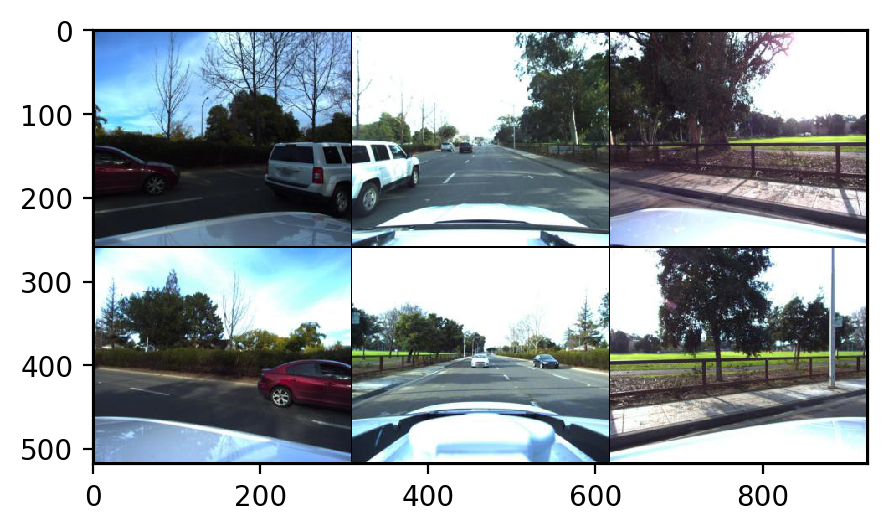

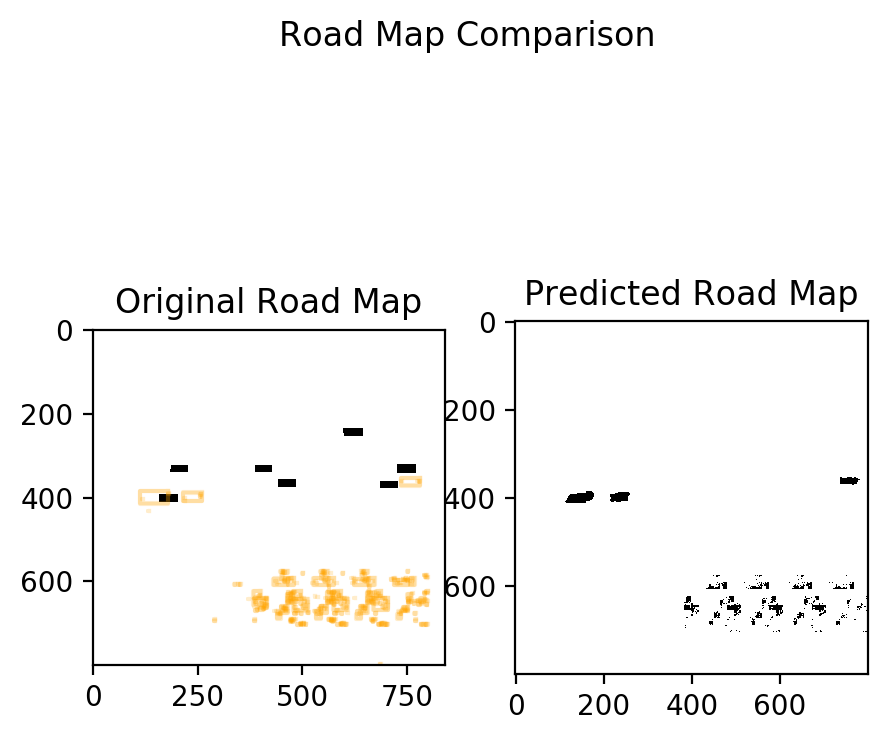

--------------------
Test Sample: 1


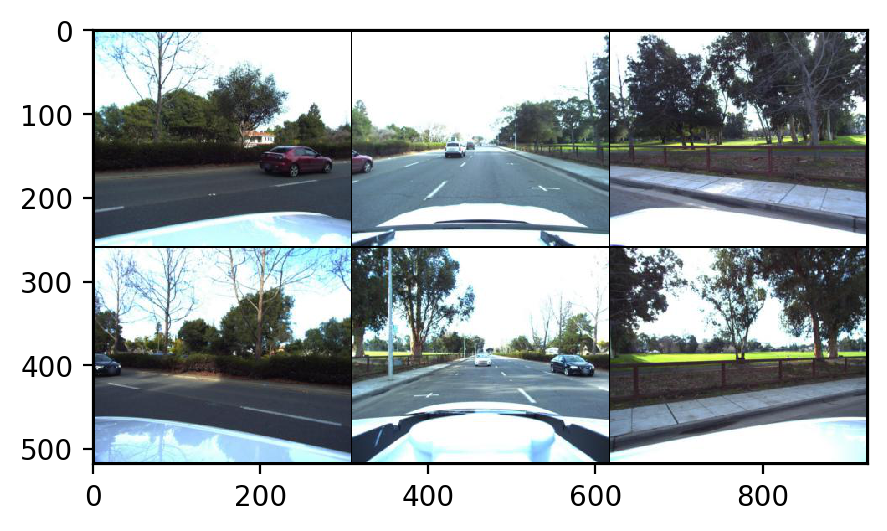

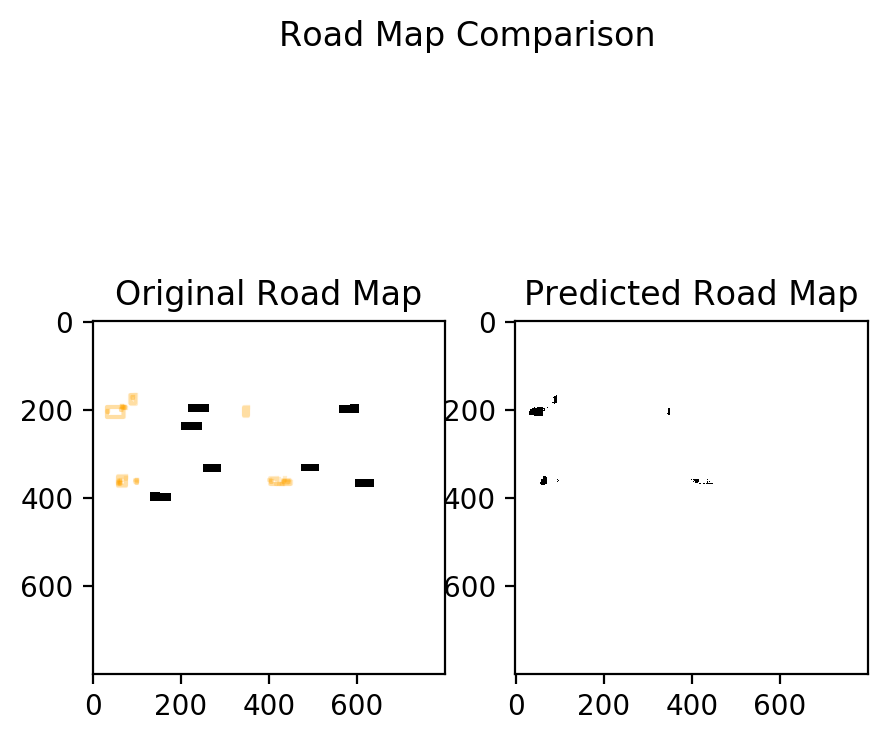

--------------------
Test Sample: 2


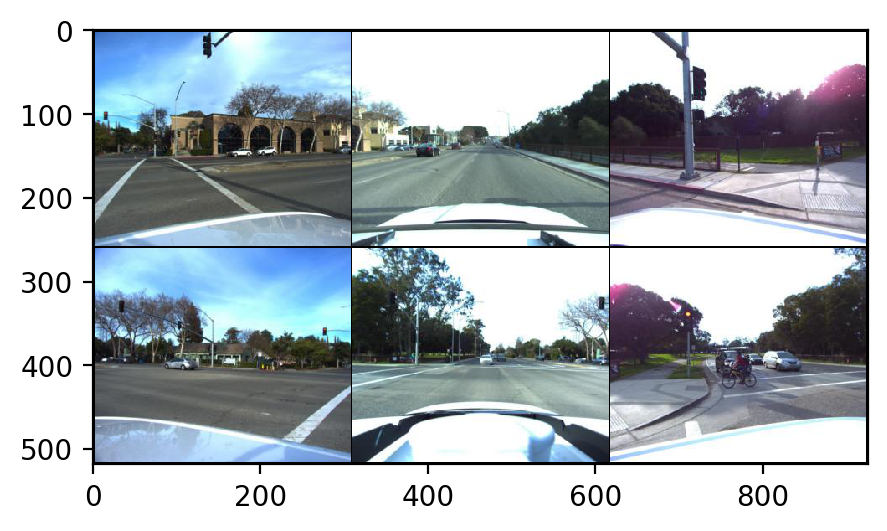

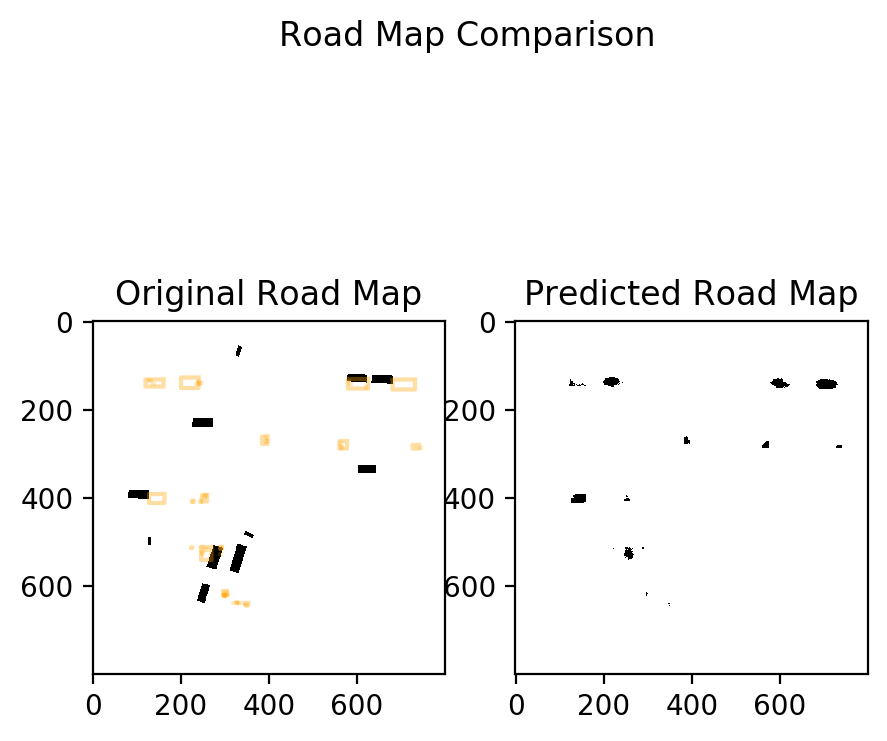

--------------------
Test Sample: 3


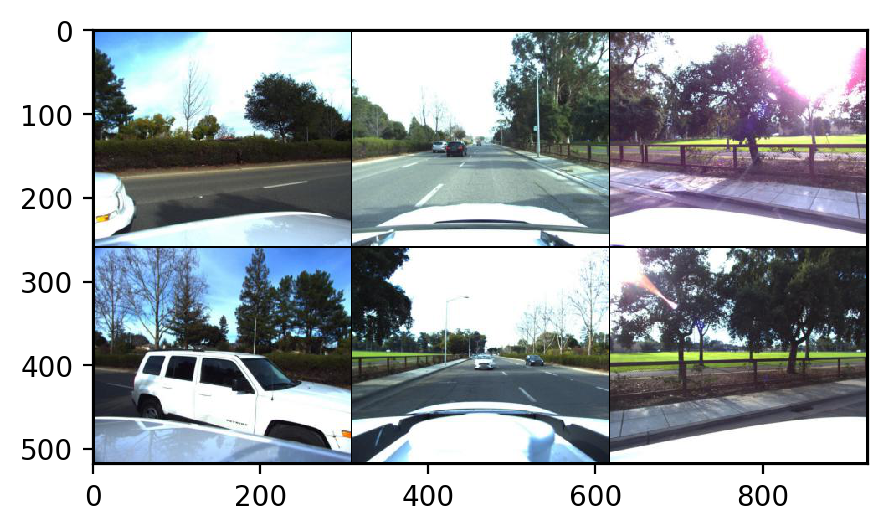

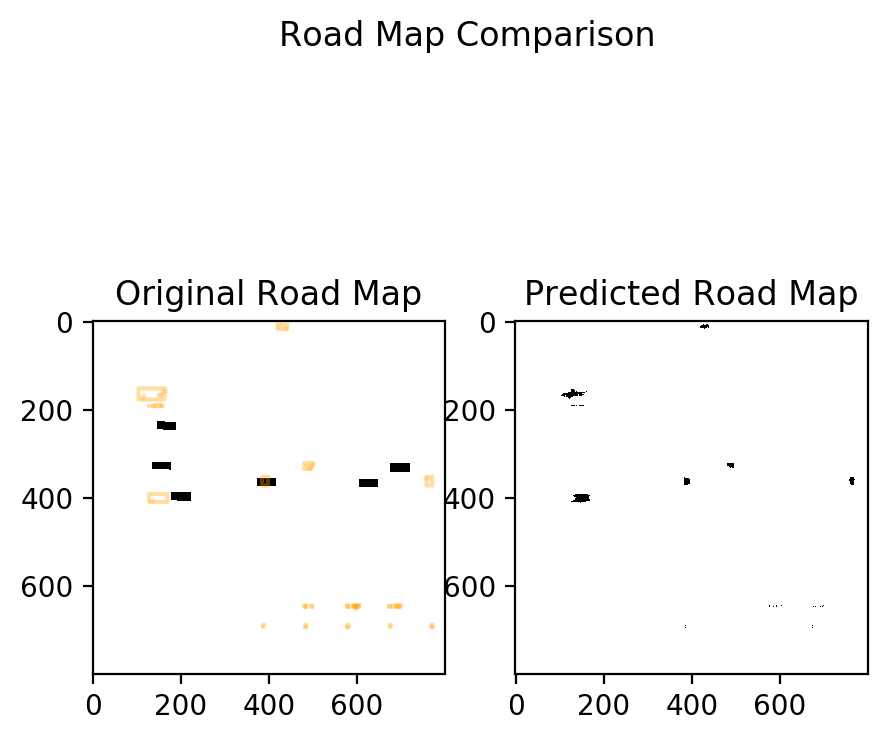

--------------------
Test Sample: 4


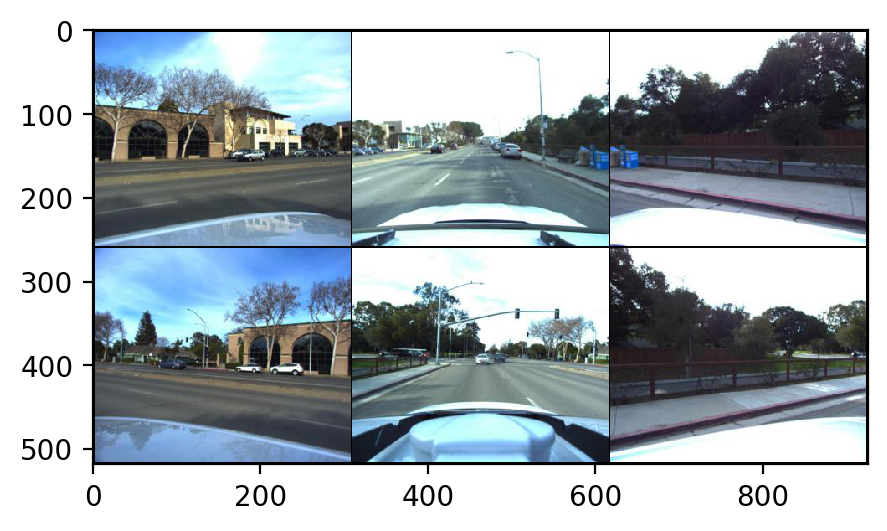

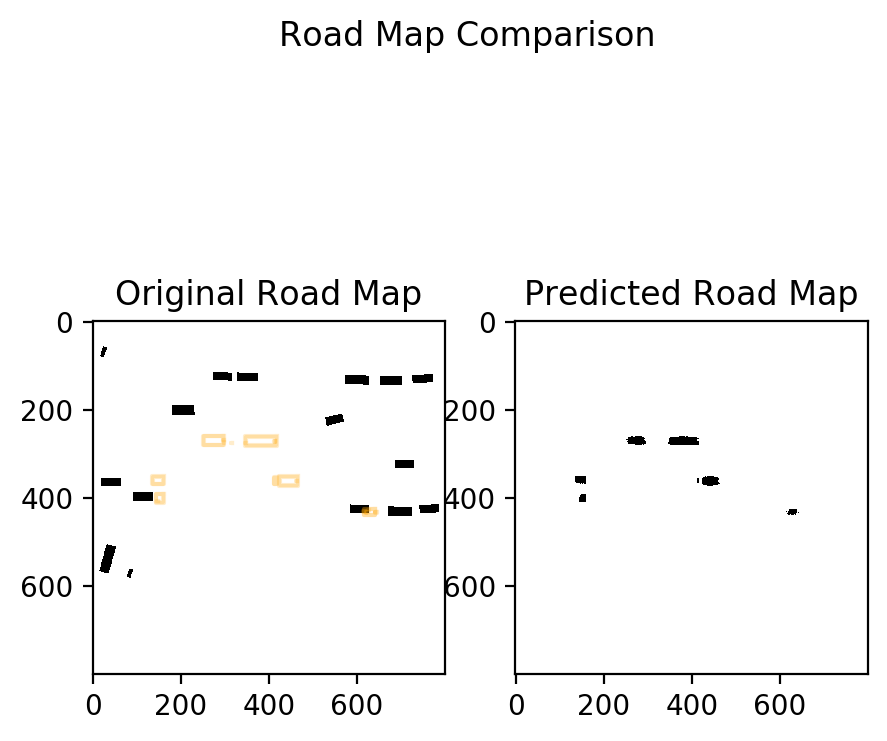

--------------------
Total samples: 5.0, Total Threat Score: 0.017742158845067024
Mean Threat Score is: 0.003548431908711791


In [31]:
print(model_type)
print('Restoring Best checkpoint from {}'.format(best_checkpoint_path))
state = torch.load(best_checkpoint_path)
epoch = state['epoch']
model.load_state_dict(state['state_dict'])

model.eval()

threat_score = 0.0
total = 0.0
display_images = True

for i, temp_batch in enumerate(testloader):
    if i == 5:
        break
        
    total += len(temp_batch[0])
    samples, targets, tar_sems, road_images, extra = temp_batch
    samples = torch.stack(samples)

    if model_type == 'ae':
        pred_maps = model(samples.to(device))
    elif model_type == 'vae':
        pred_maps, mu, logvar = model(samples.to(device),is_training=False)
    
    ts_road_map = compute_ts_road_map(pred_maps[0].to(device) > threshold, road_images[0].to(device))
    threat_score += ts_road_map
    if display_images:
        print('Test Sample: {}'.format(i))
        plt.imshow(torchvision.utils.make_grid(samples[0], nrow=3).numpy().transpose(1, 2, 0))
            # CAM_FRONT_LEFT, CAM_FRONT, CAM_FRONT_RIGHT, CAM_BACK_LEFT, CAM_BACK, CAM_BACK_RIGHT
#     plt.axis('off');
        fig, (ax1, ax2) = plt.subplots(1, 2)
        fig.suptitle('Road Map Comparison')
        ax1.imshow(tar_sems[0].detach().cpu(), cmap='binary');
        boxes = utils.get_bounding_boxes_from_seg(pred_maps[0] > 0.2, 10, 800, 800)
        for i, bb in enumerate(boxes):
            # You can check the implementation of the draw box to understand how it works
            draw_box(ax1, bb, color="orange", alpha=0.2)
        ax1.set_title('Original Road Map')
        ax2.imshow((pred_maps[0] > 0.2).detach().cpu(), cmap='binary');
        ax2.set_title('Predicted Road Map')
        plt.show()
        print('-'*20)
    
threat_score /= total
print('Total samples: {}, Total Threat Score: {}'.format(total,total*threat_score))
print('Mean Threat Score is: {}'.format(threat_score))

### Verifying Performance on Val set

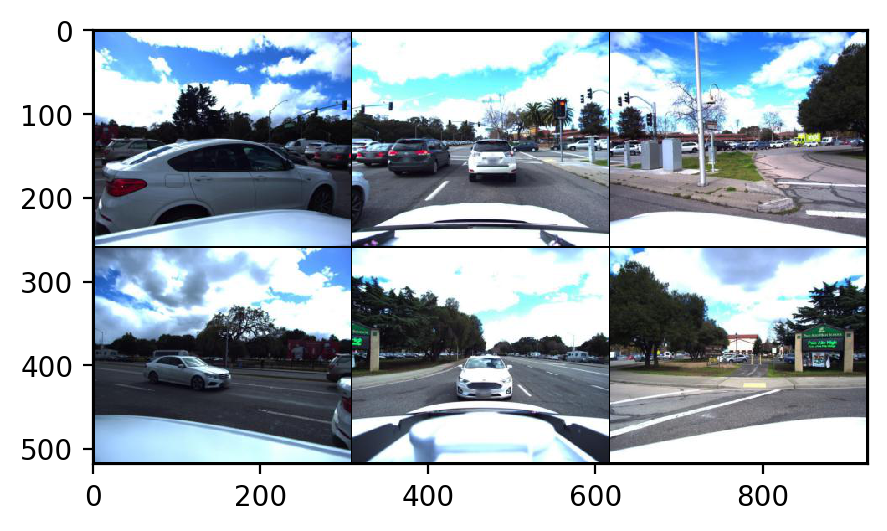

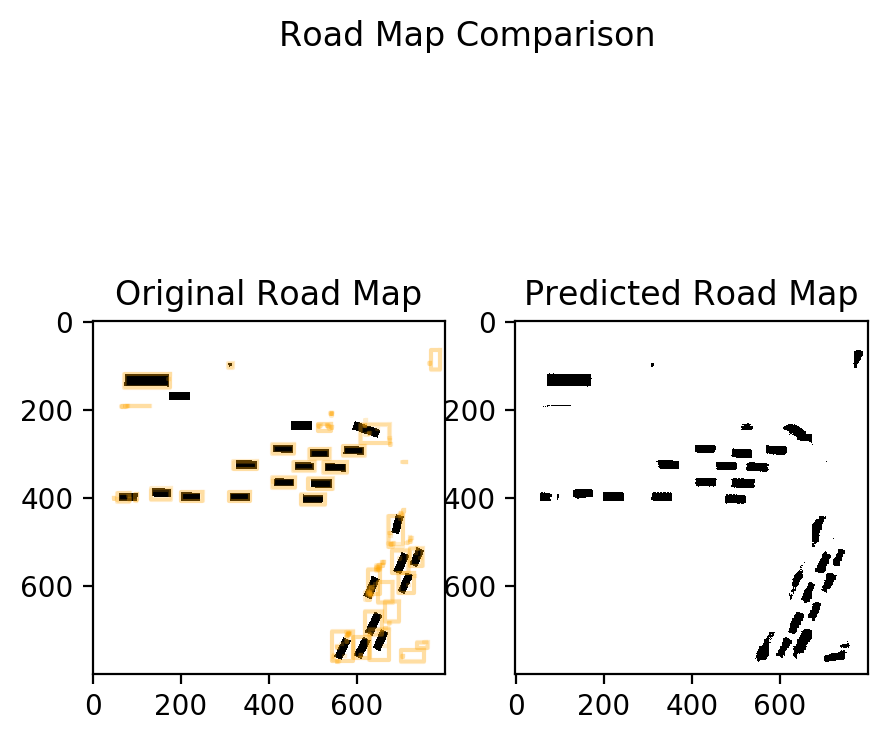

--------------------


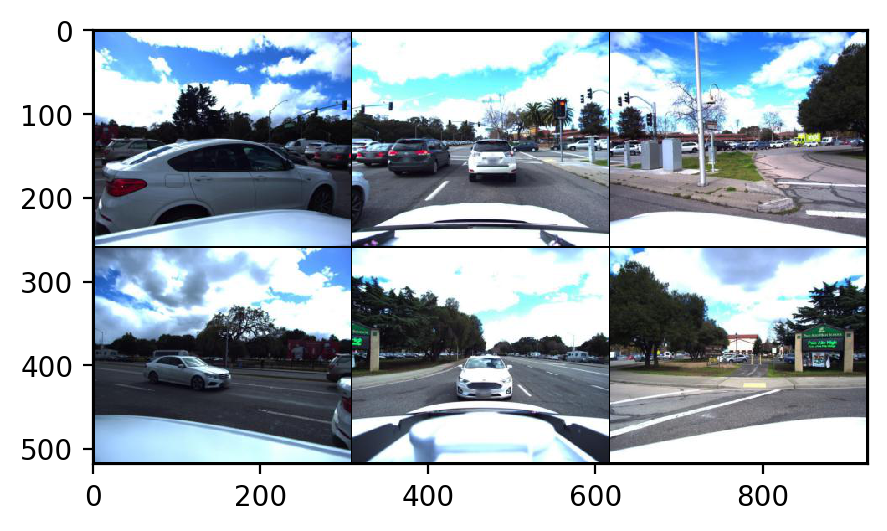

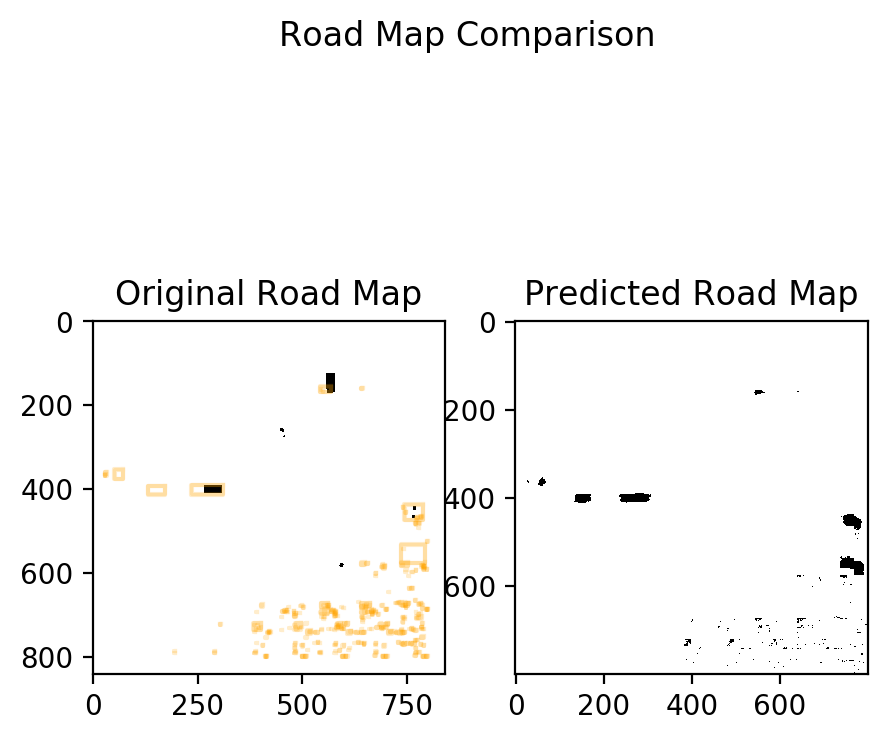

--------------------


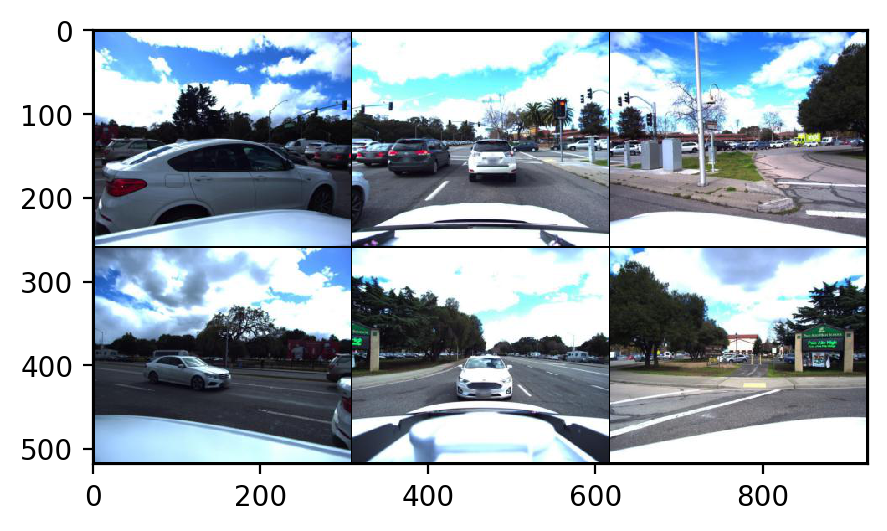

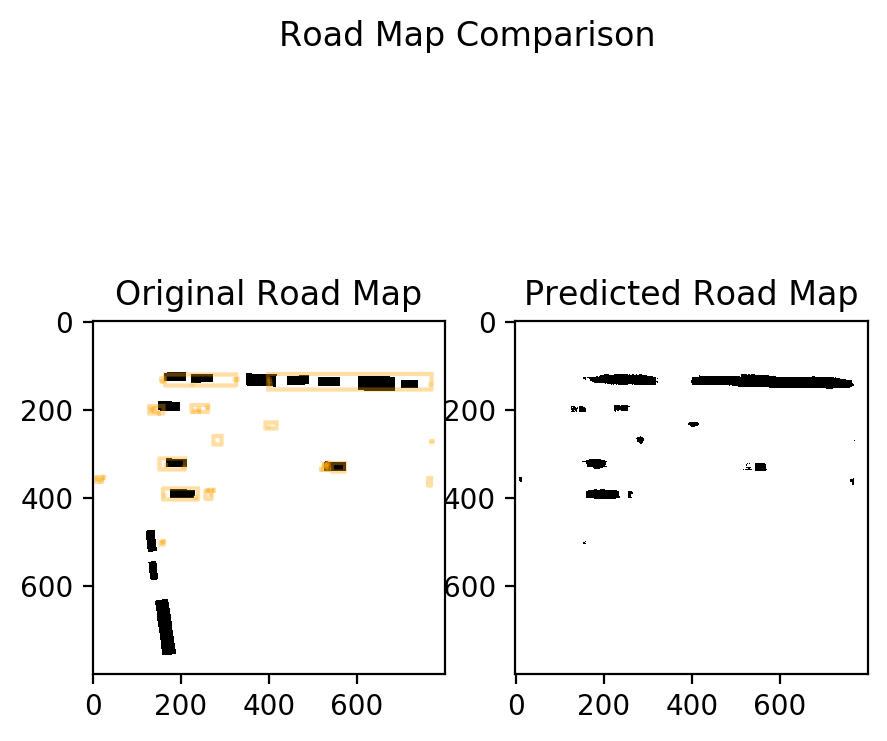

--------------------


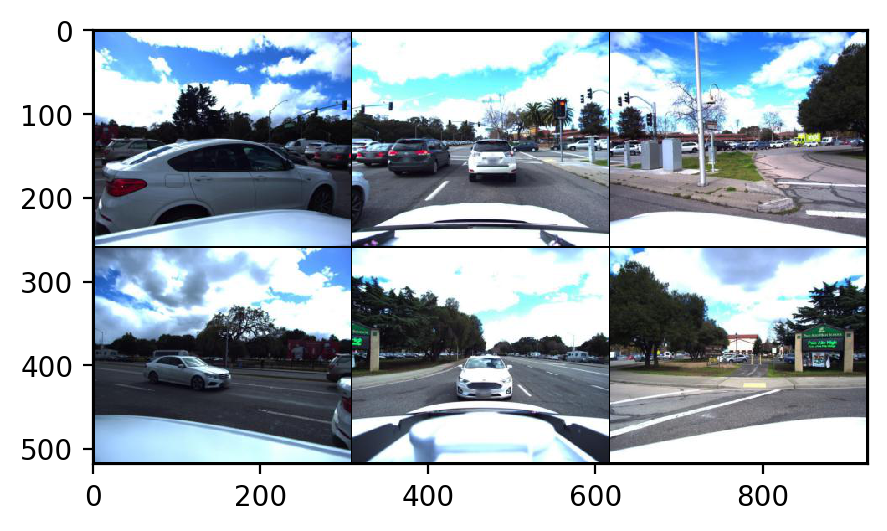

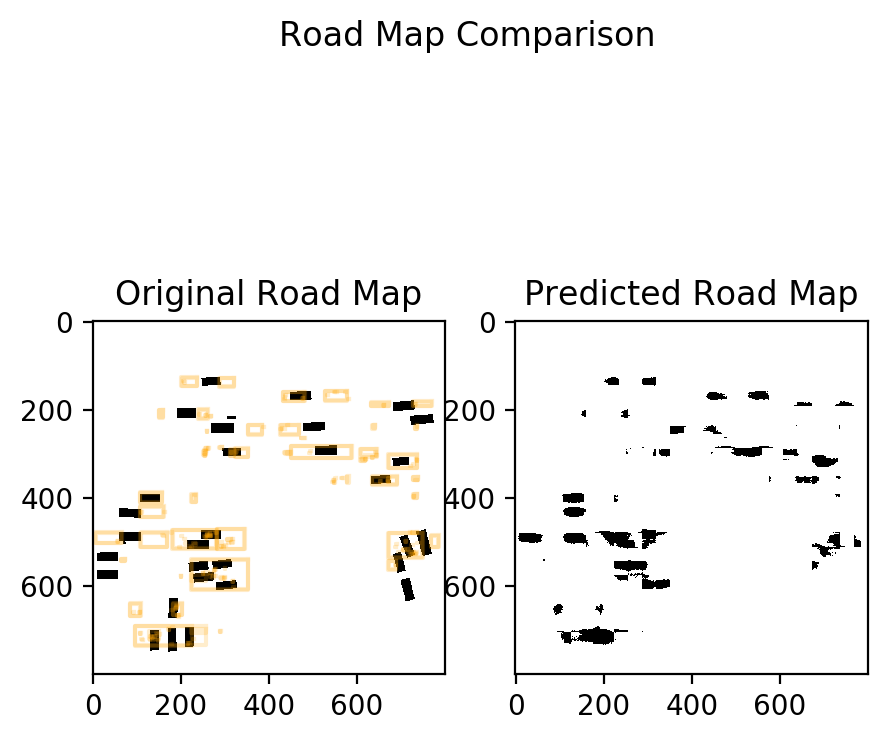

--------------------


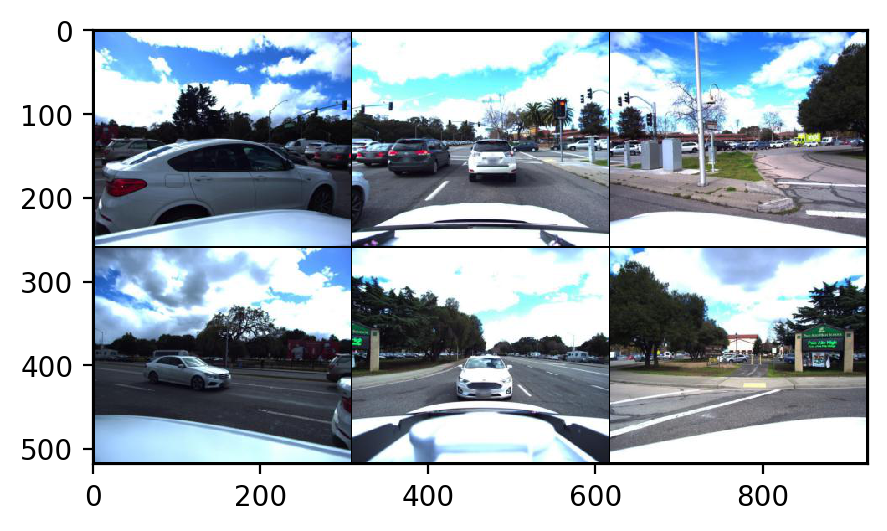

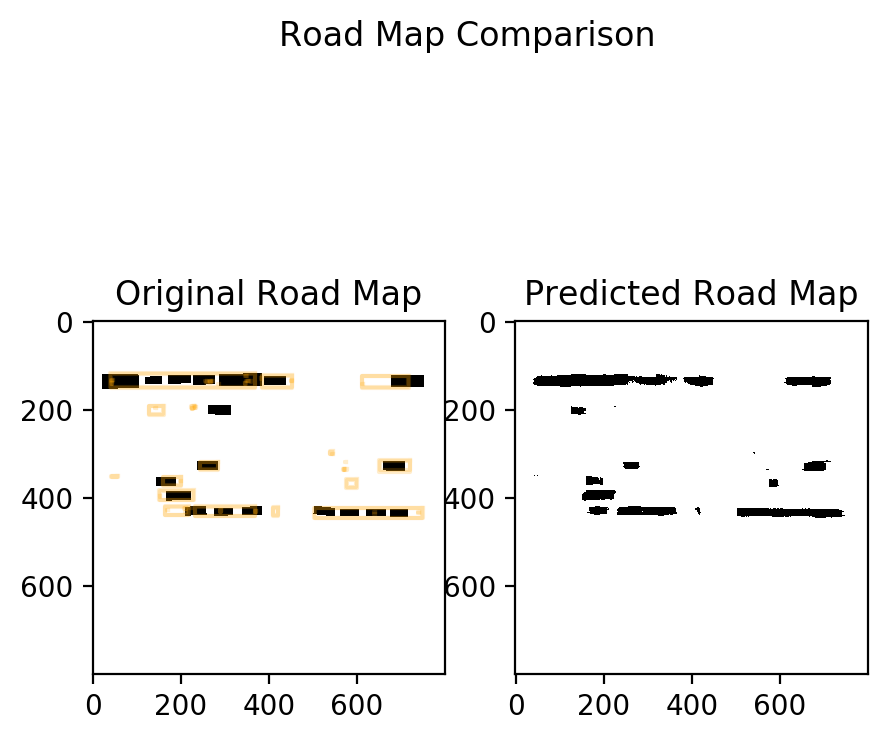

--------------------


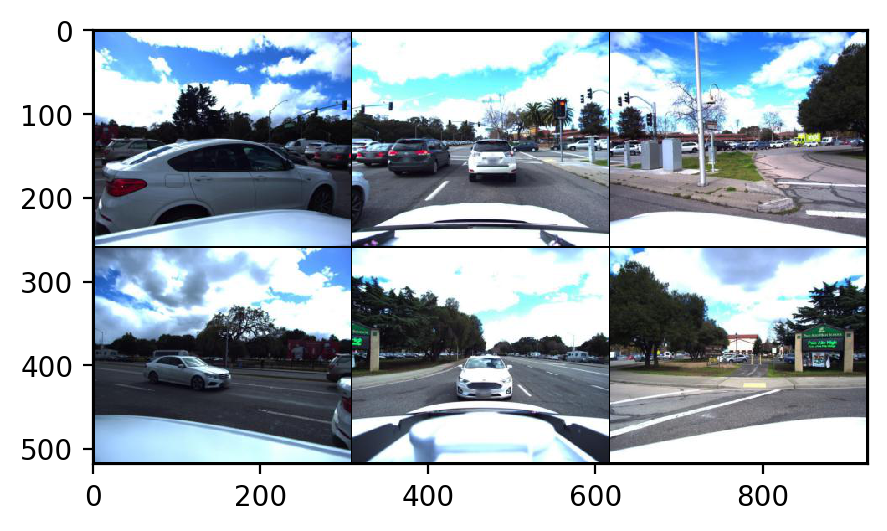

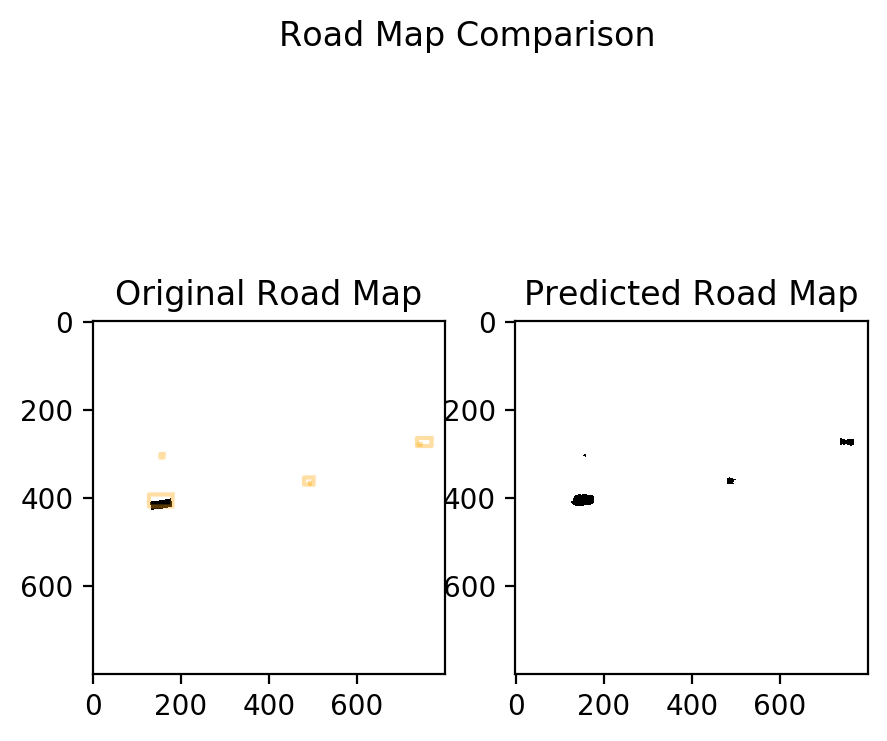

--------------------


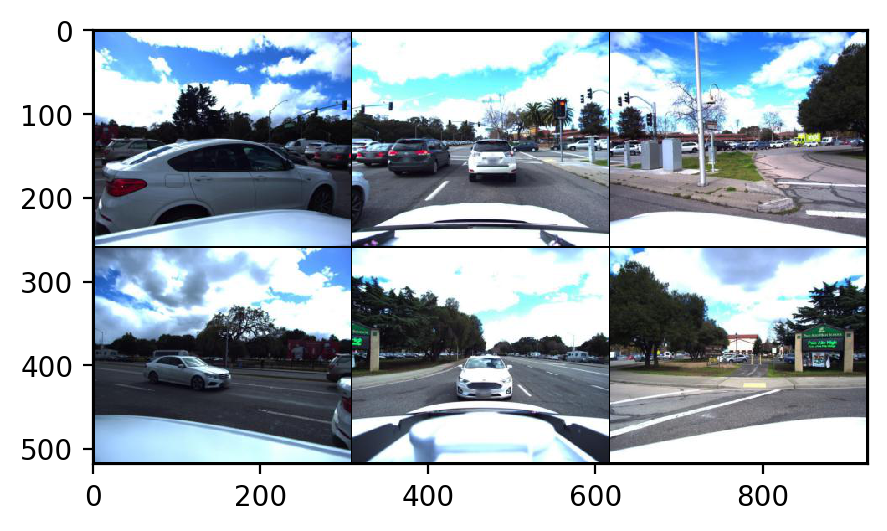

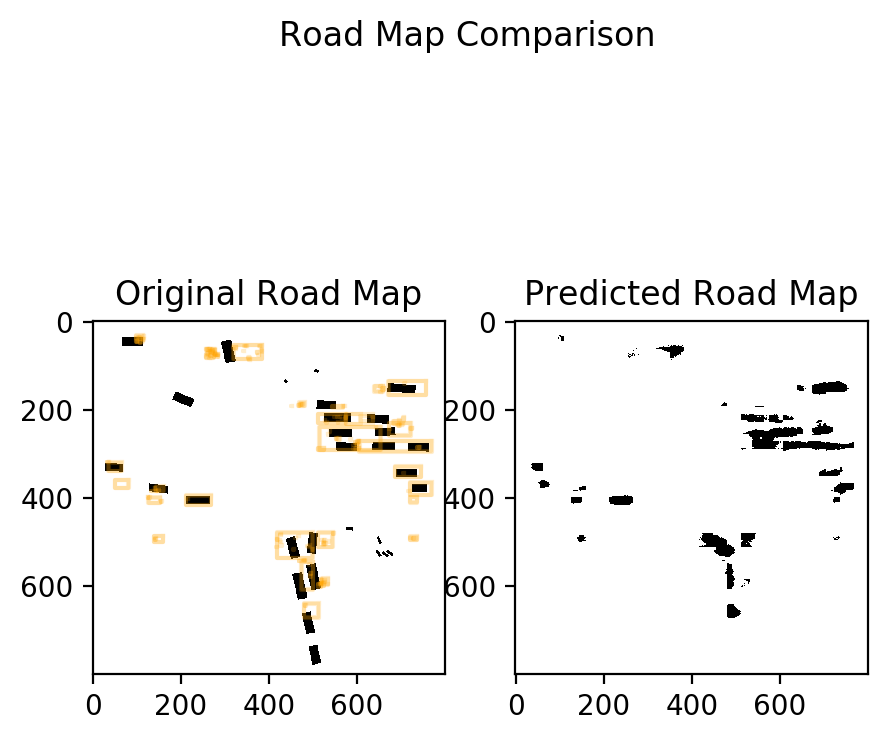

--------------------


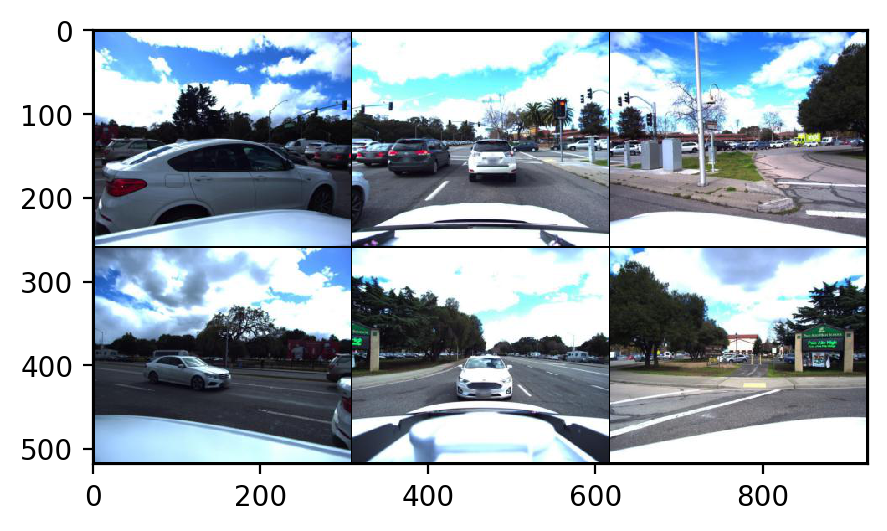

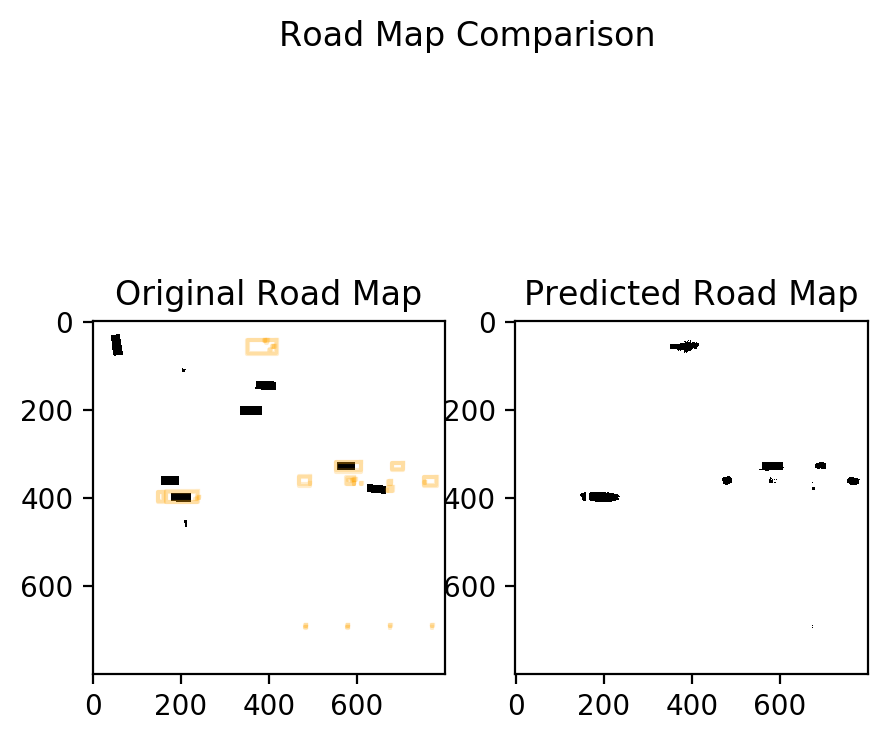

--------------------


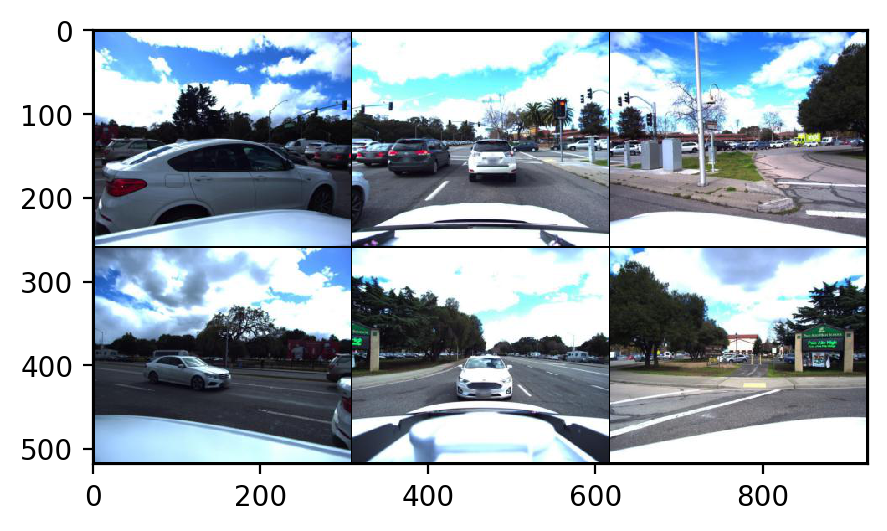

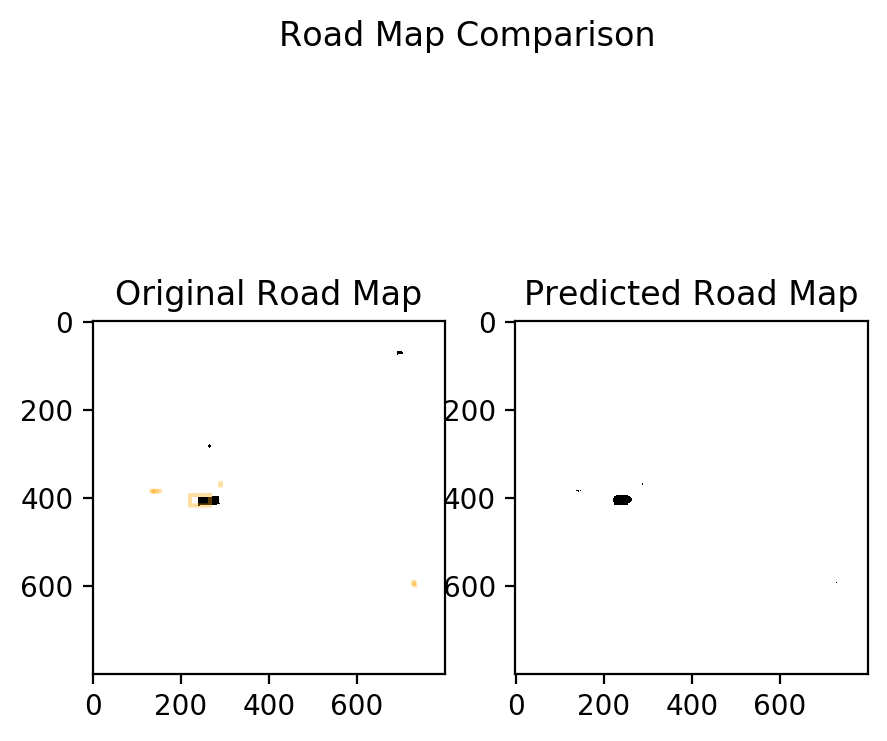

--------------------


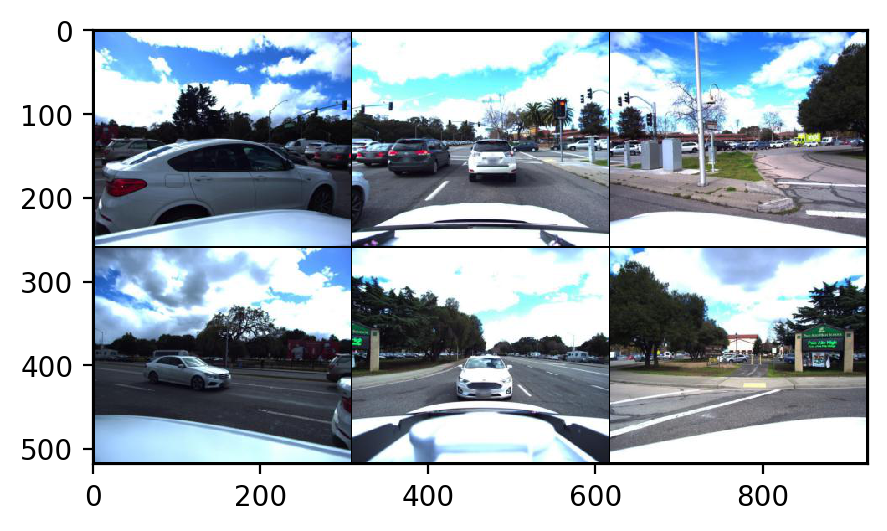

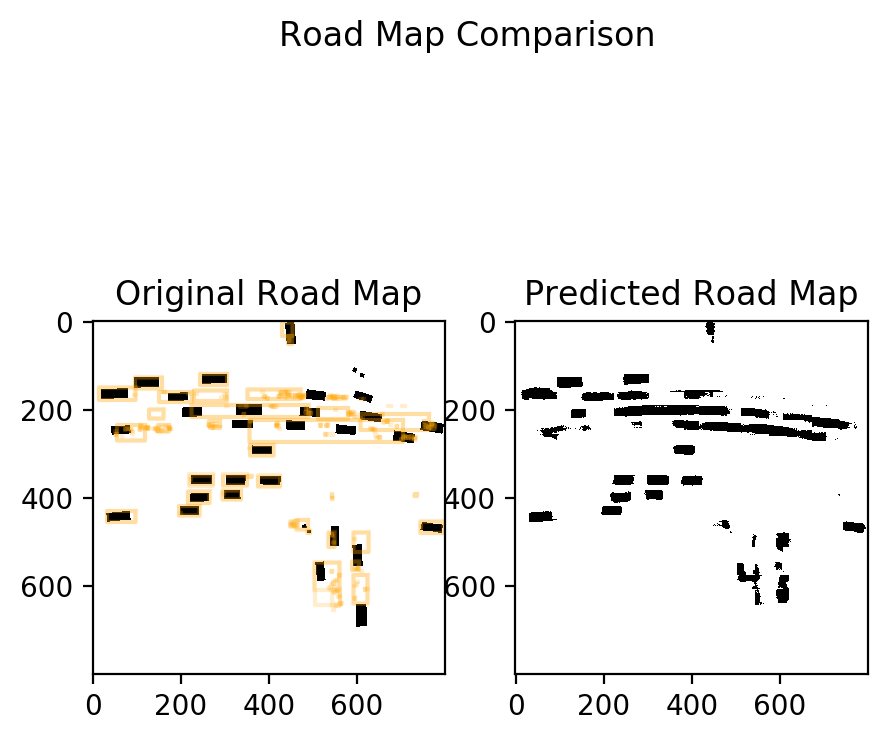

--------------------


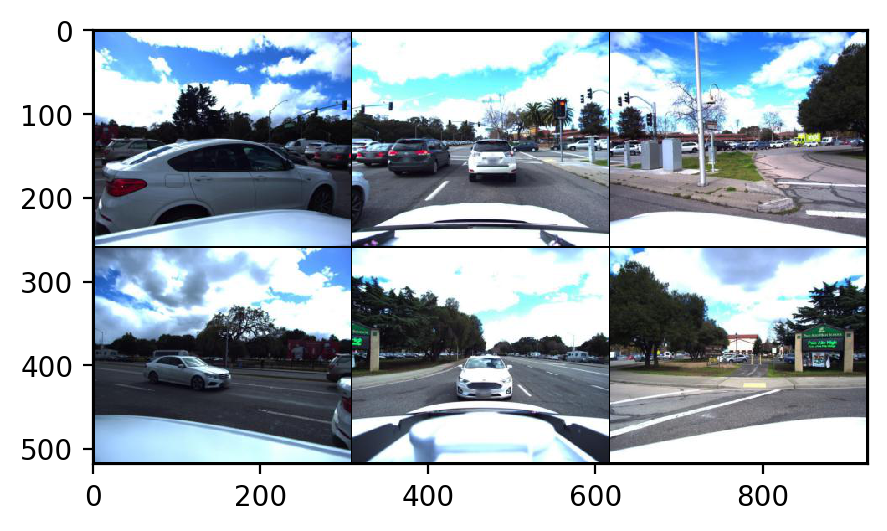

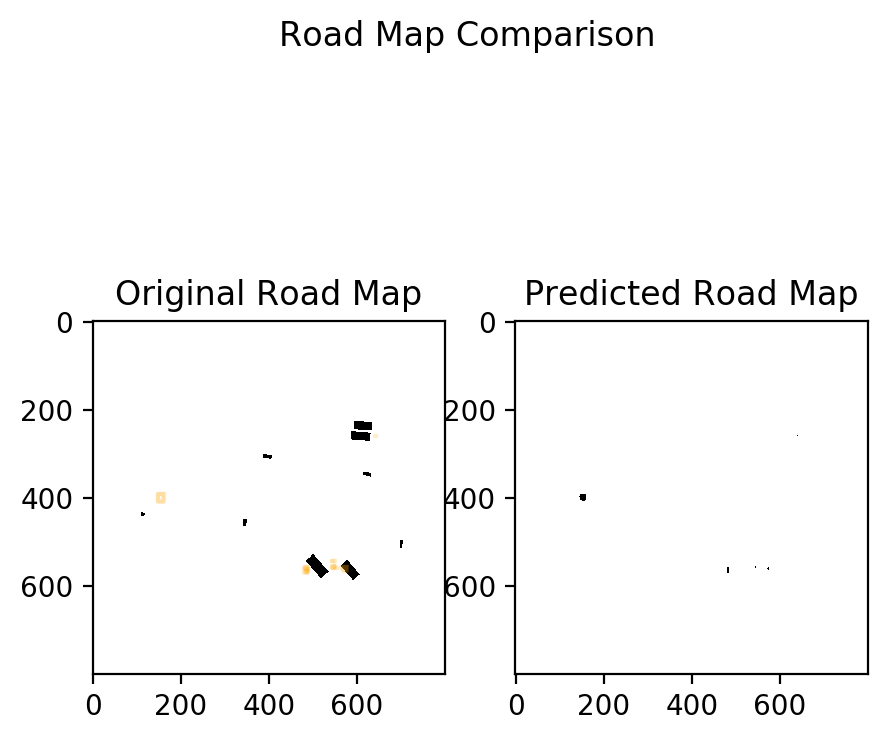

--------------------


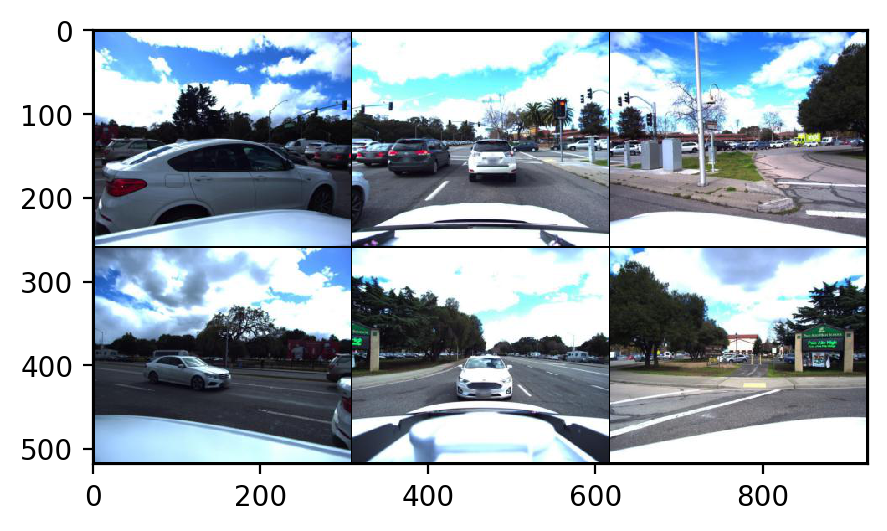

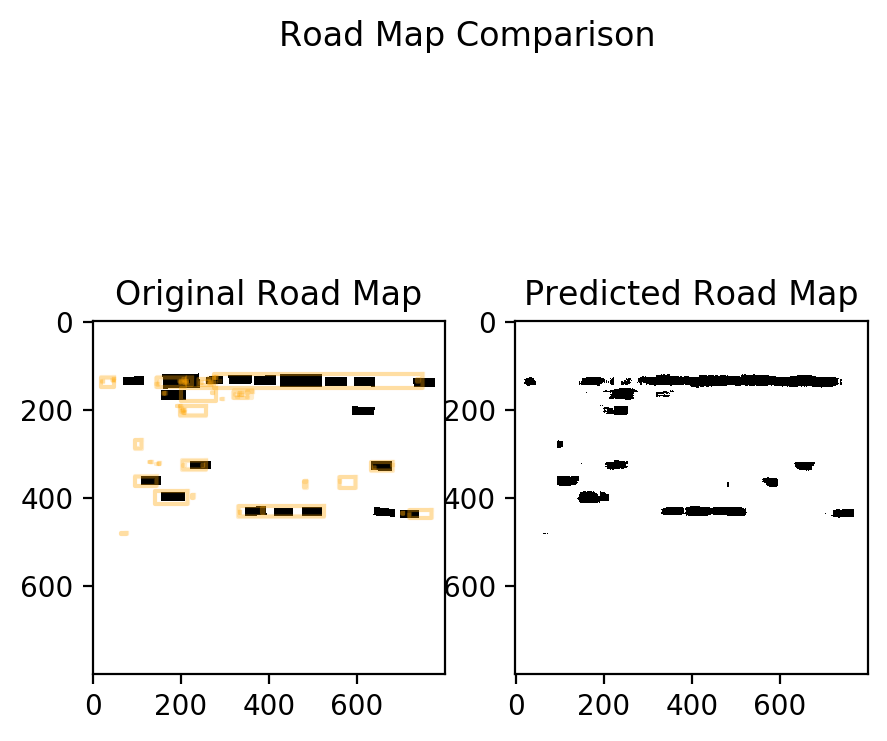

--------------------


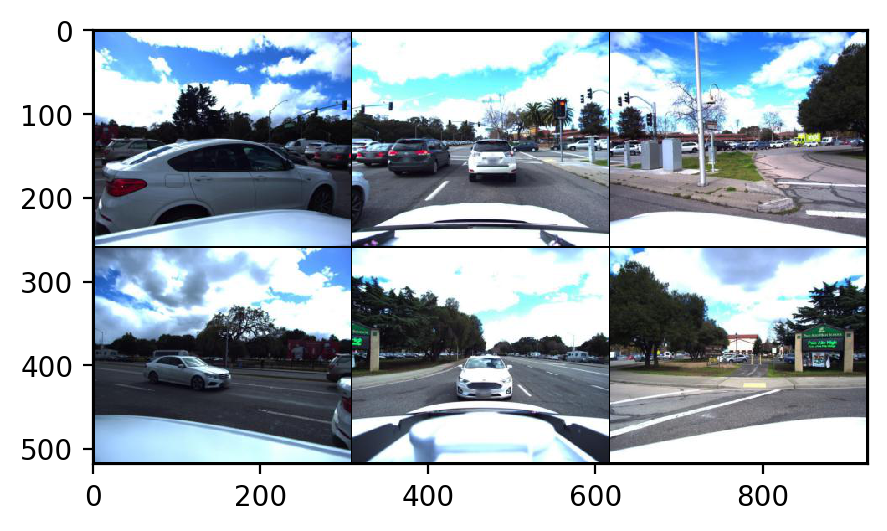

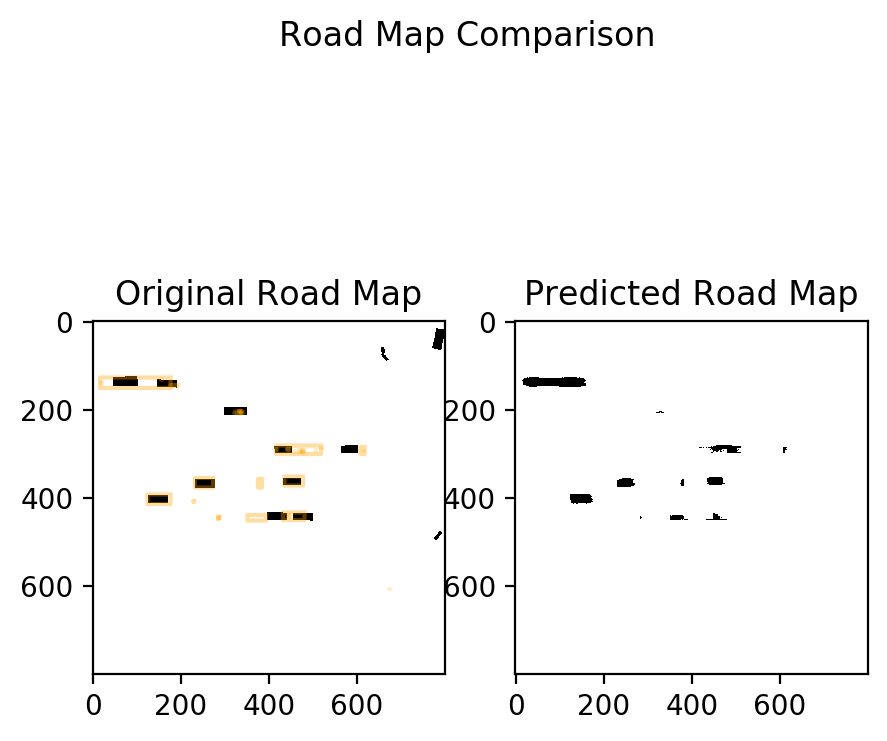

--------------------


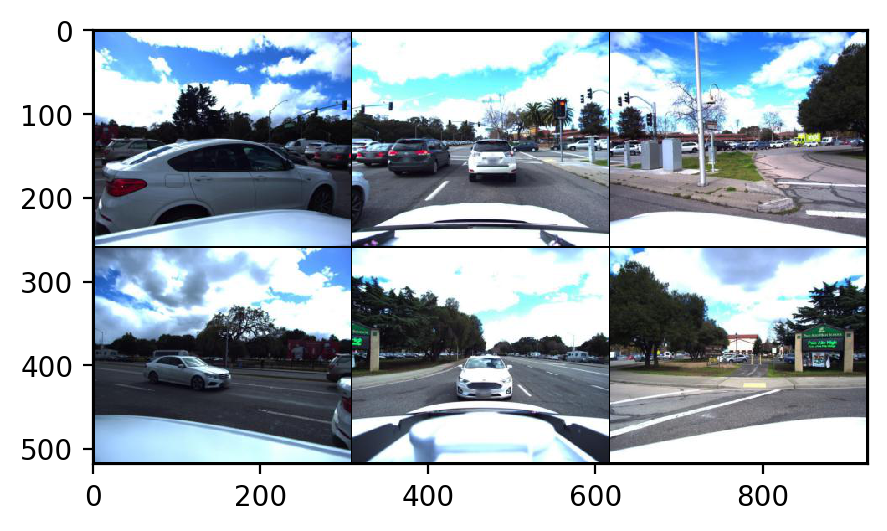

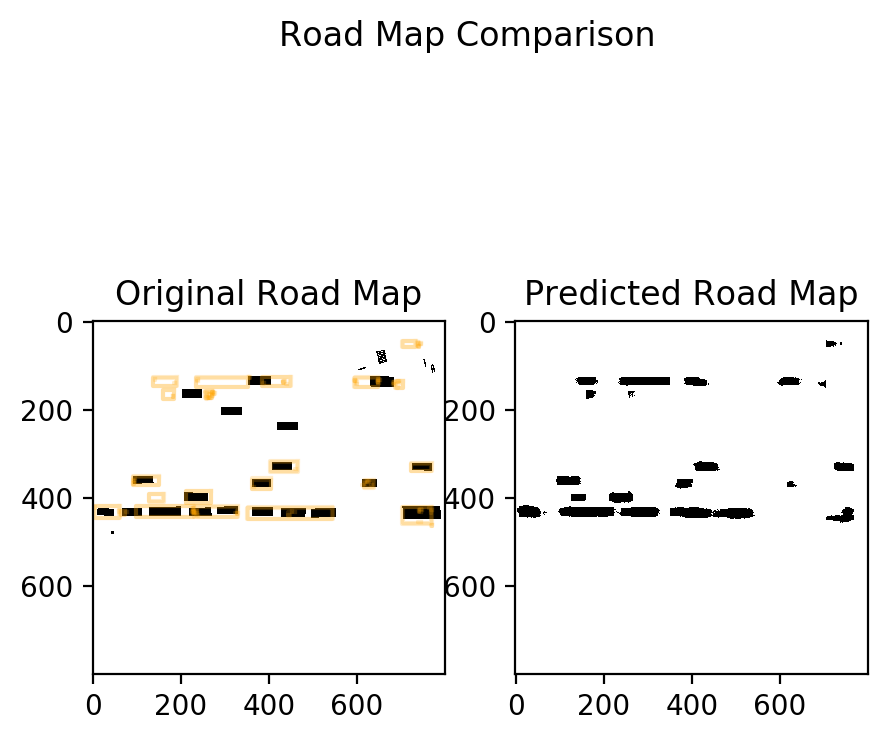

--------------------


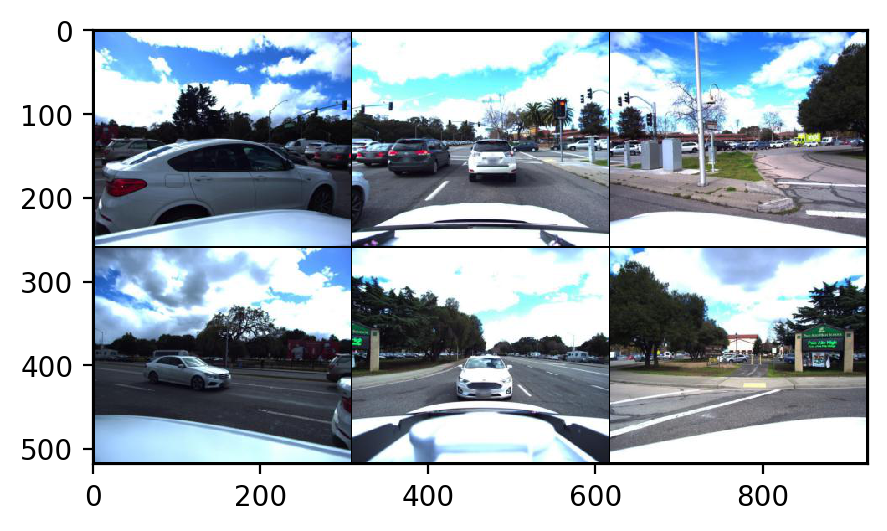

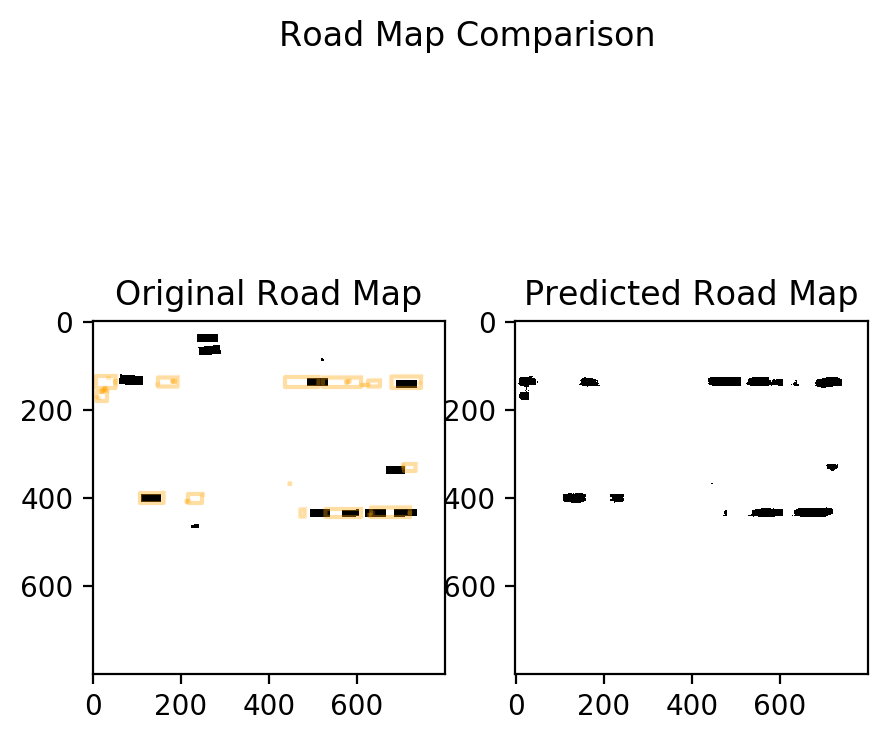

--------------------


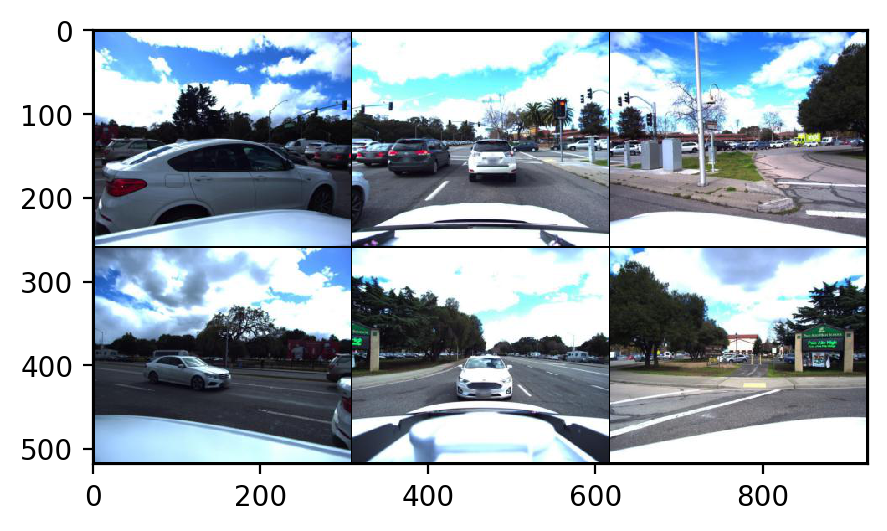

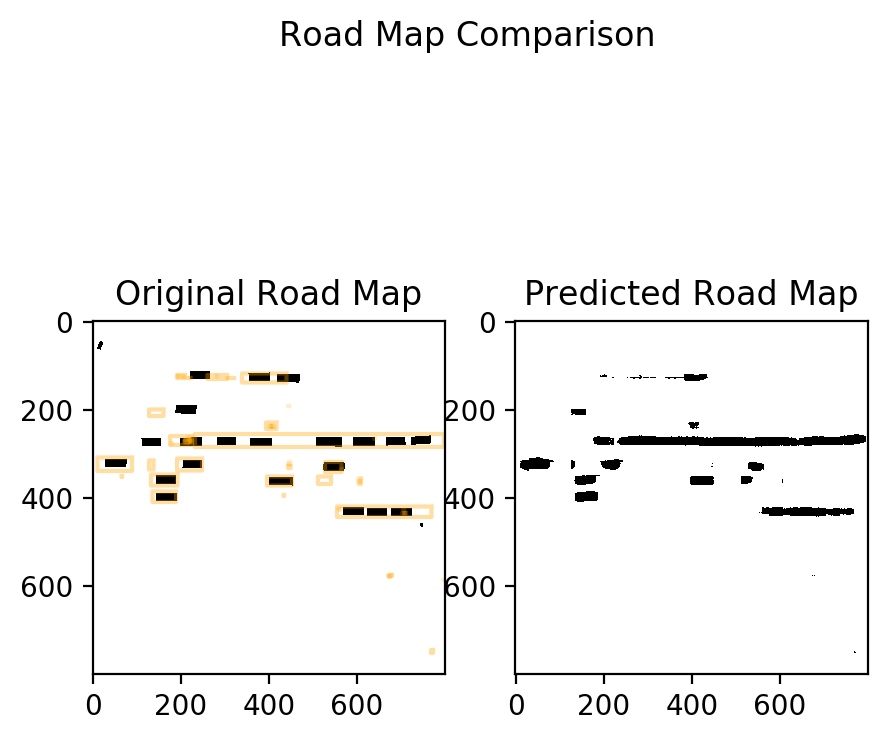

--------------------


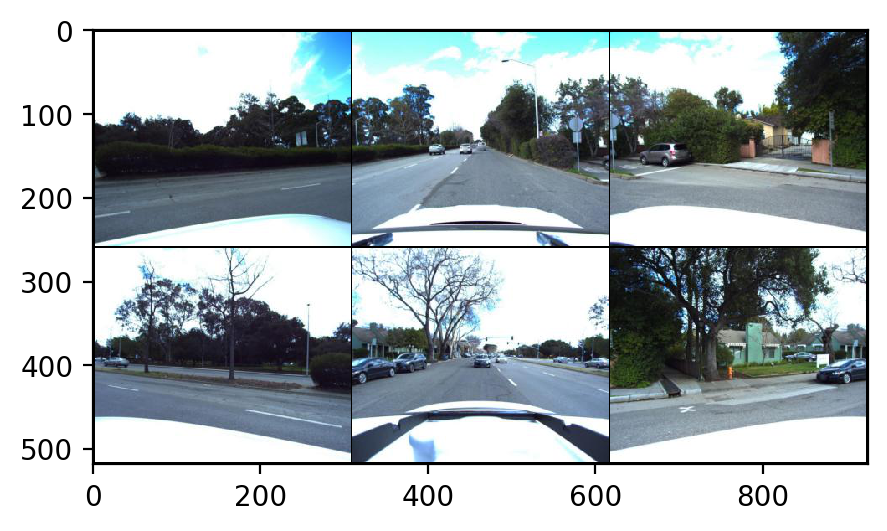

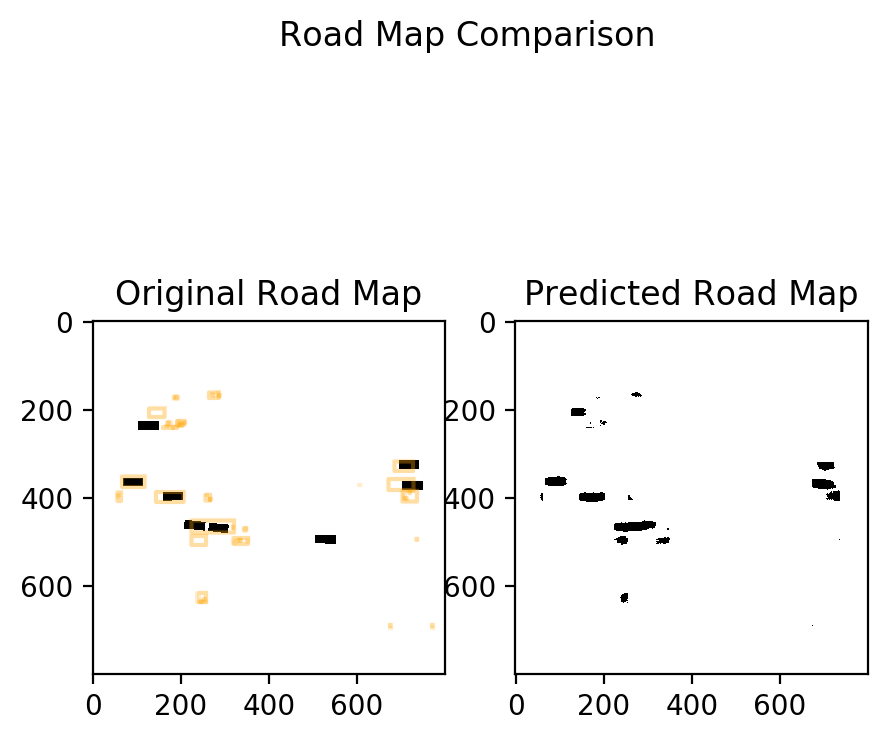

--------------------


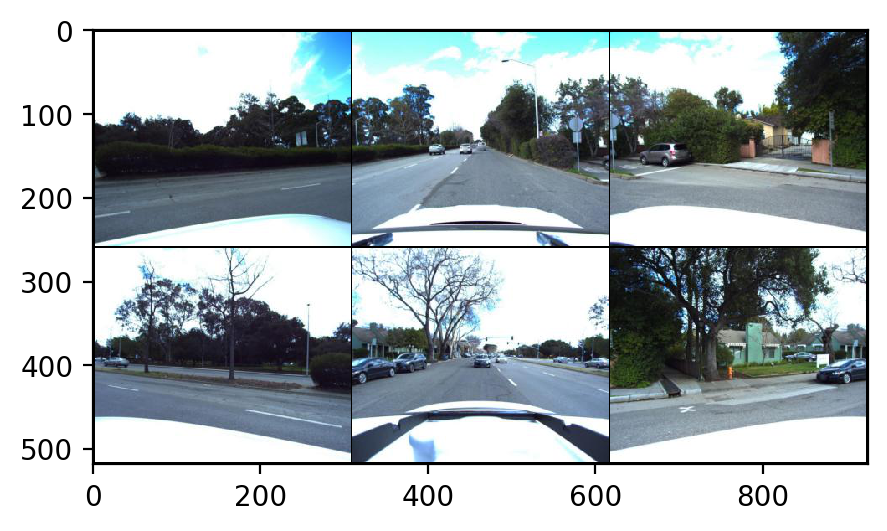

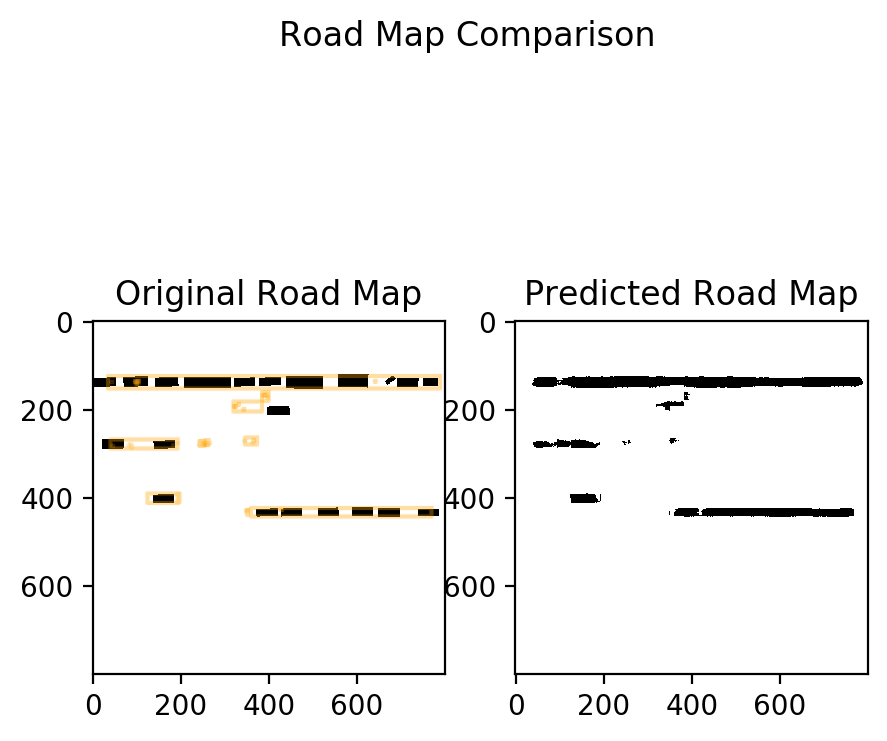

--------------------


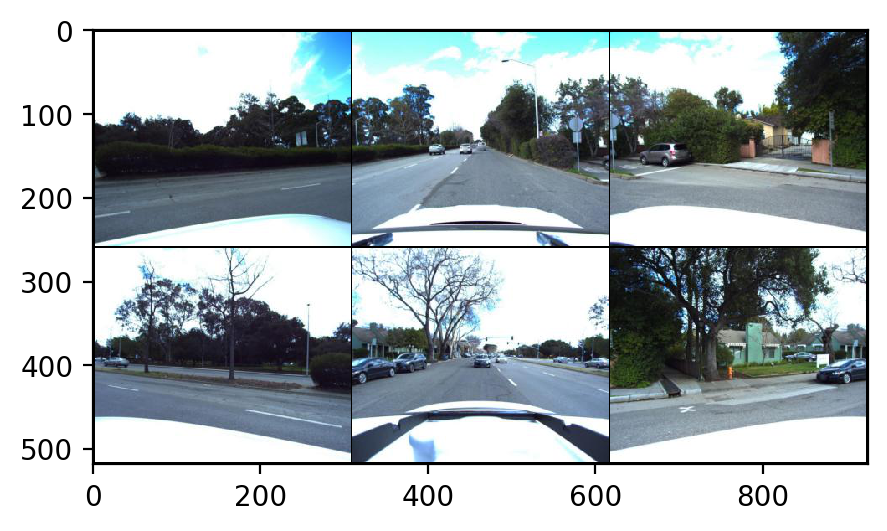

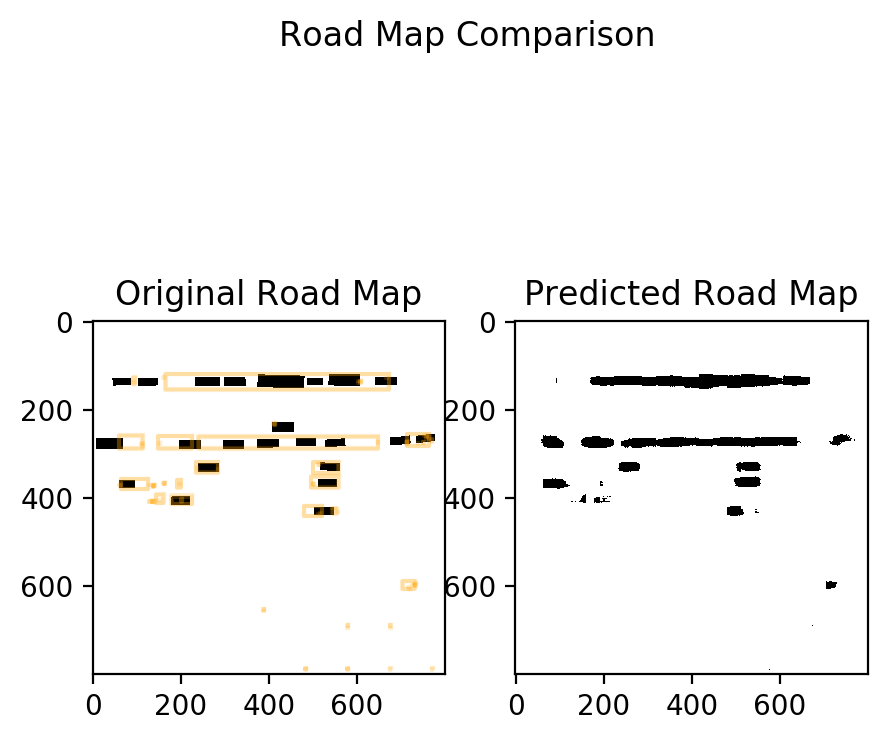

--------------------


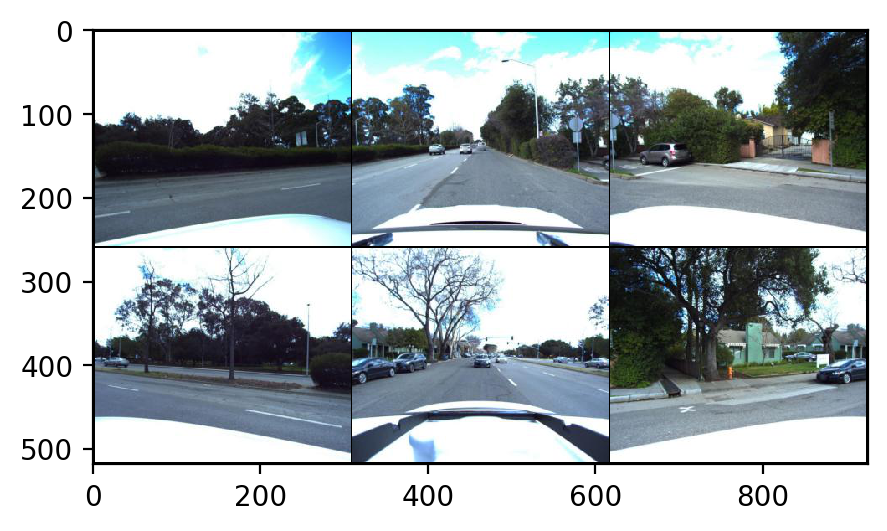

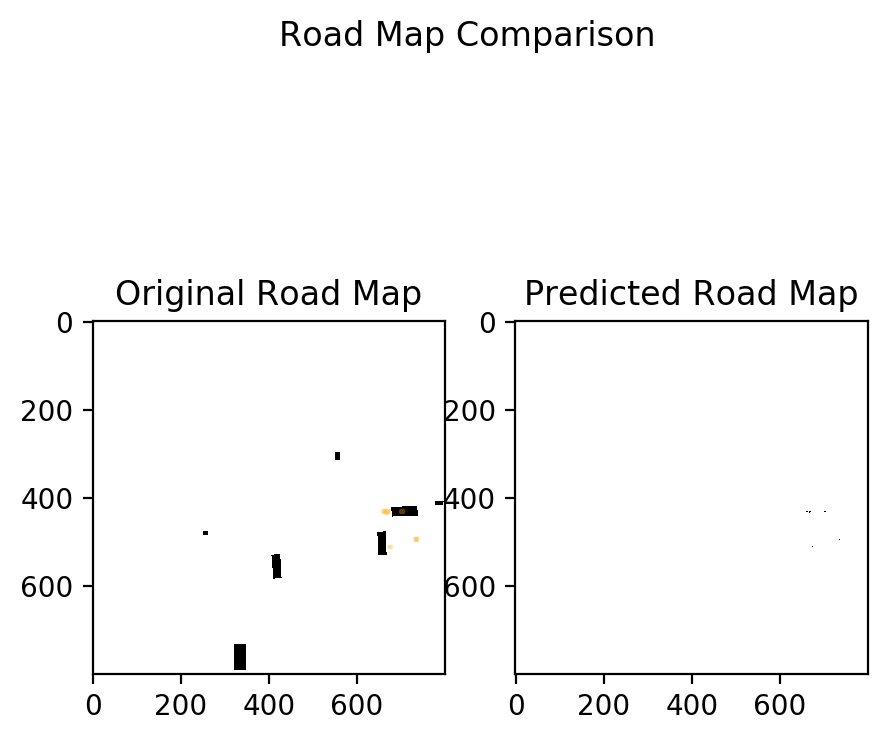

--------------------


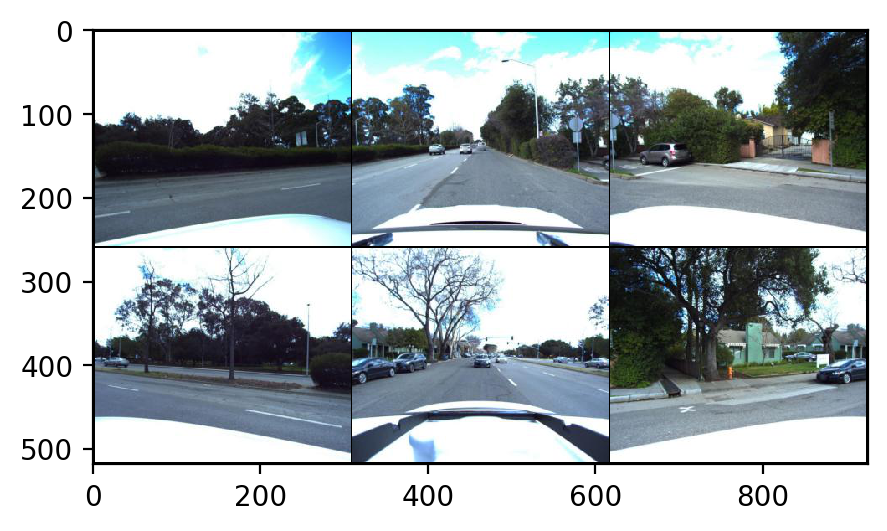

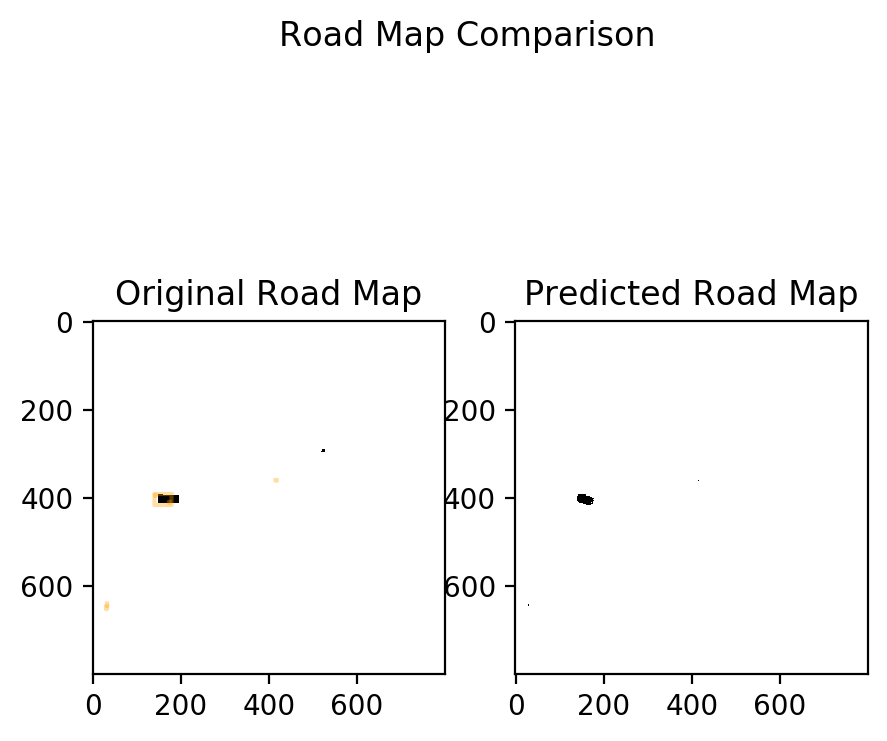

--------------------


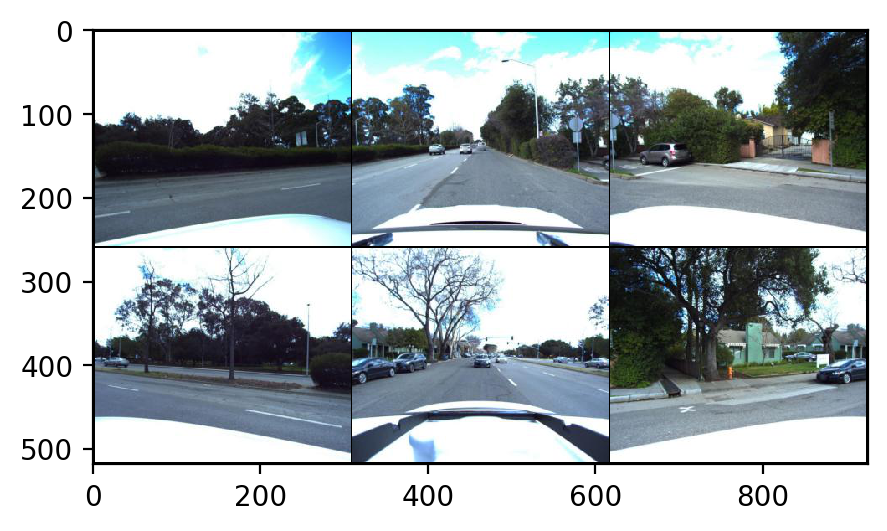

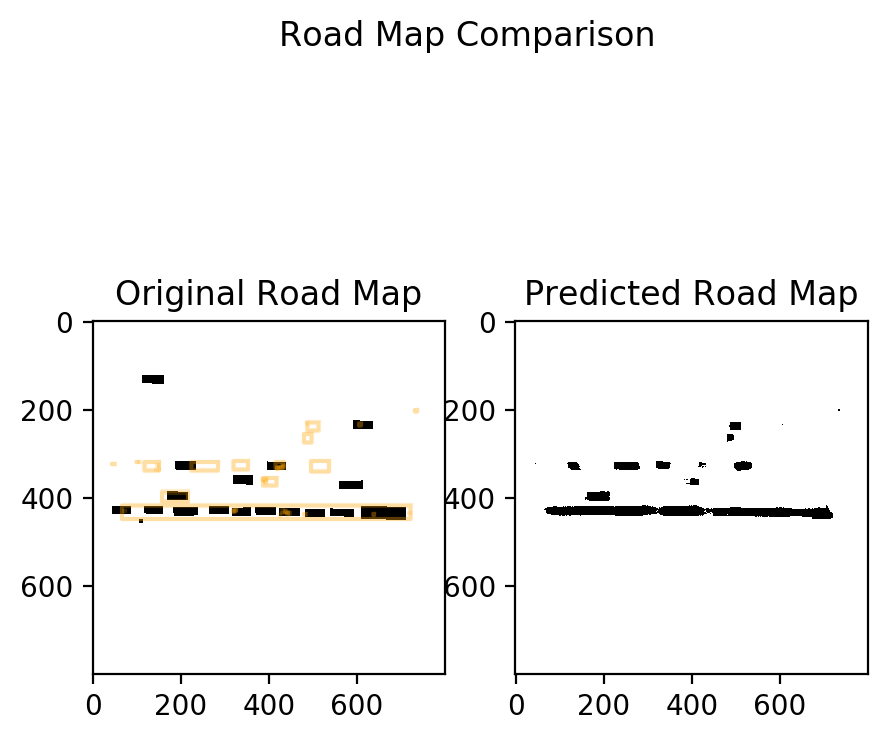

--------------------


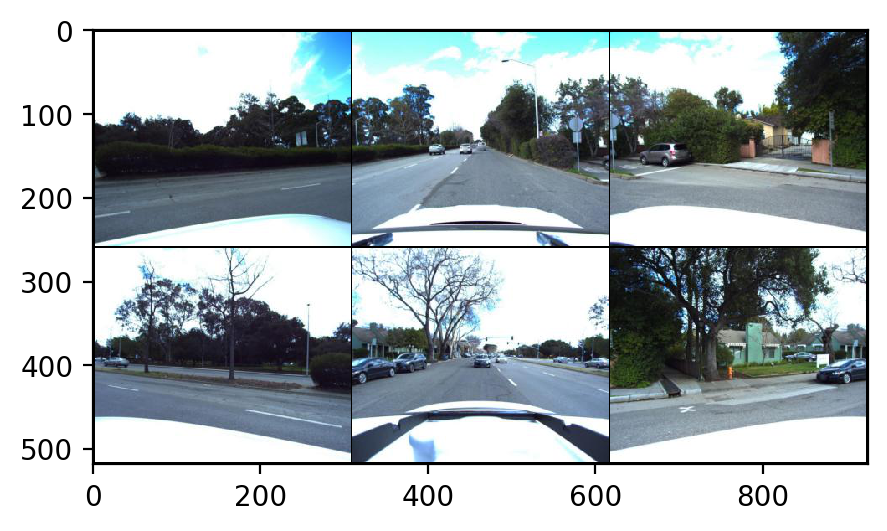

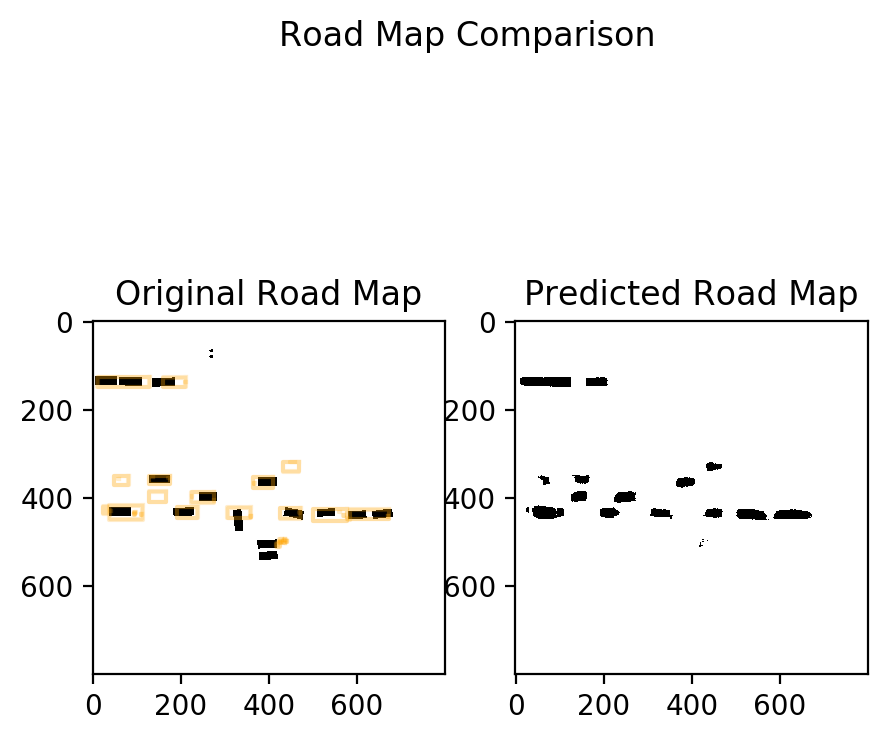

--------------------


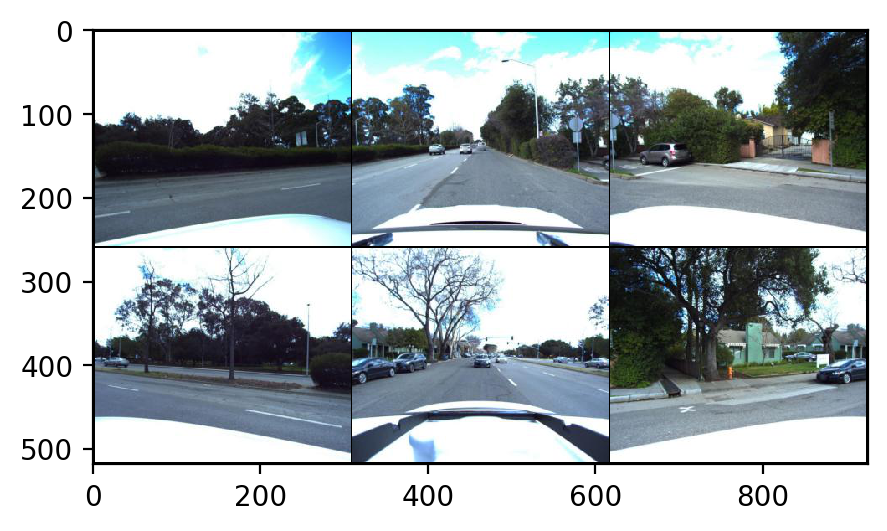

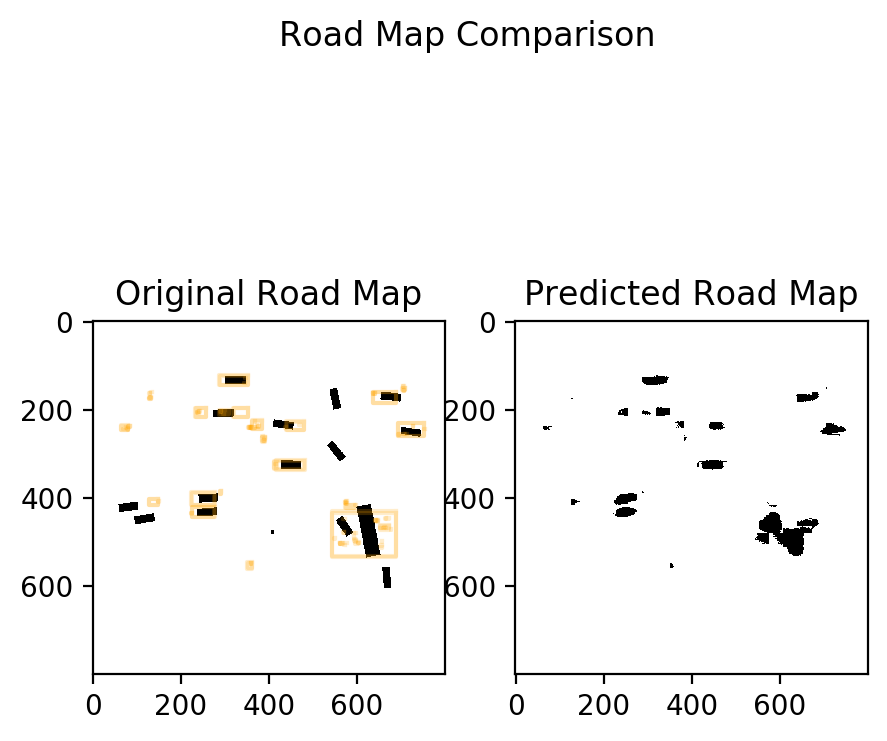

--------------------


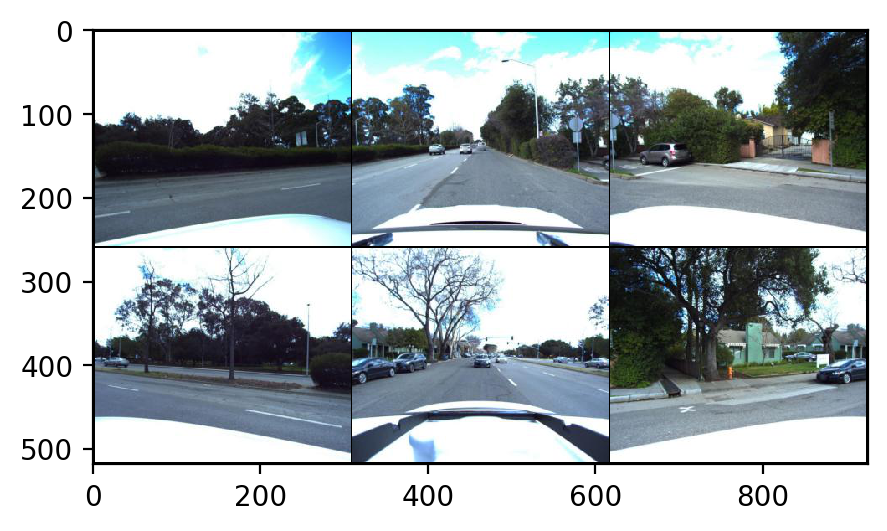

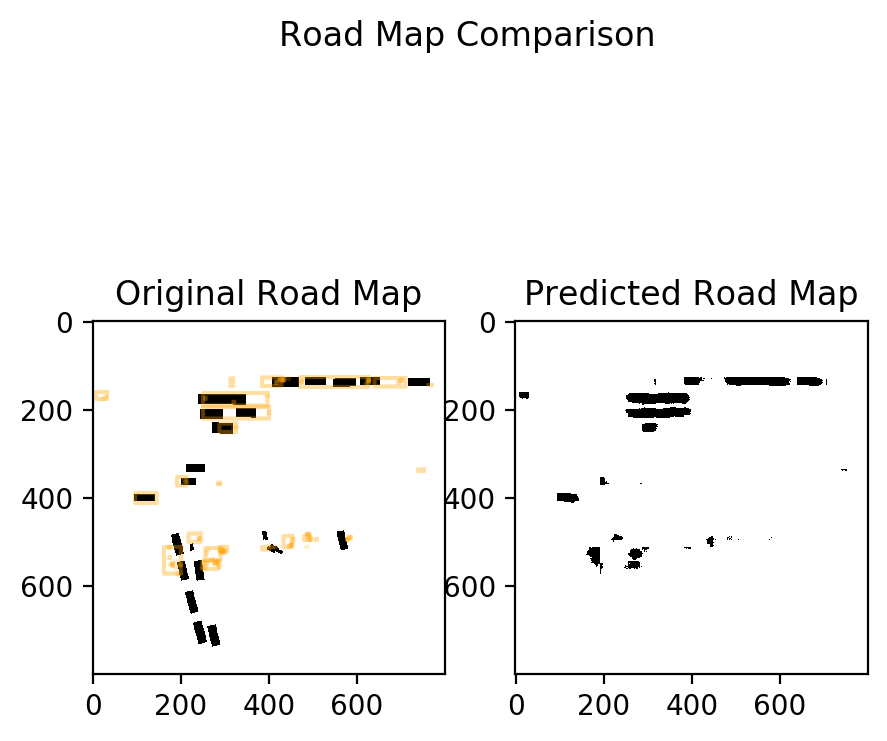

--------------------


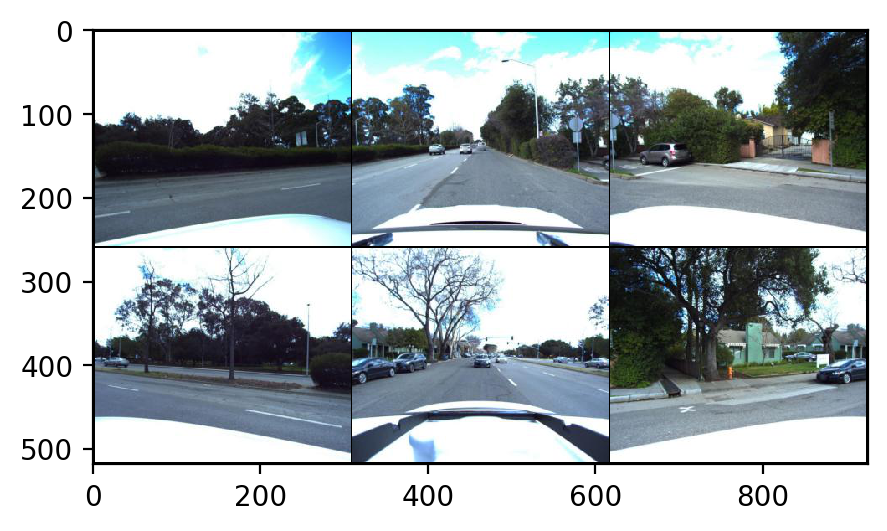

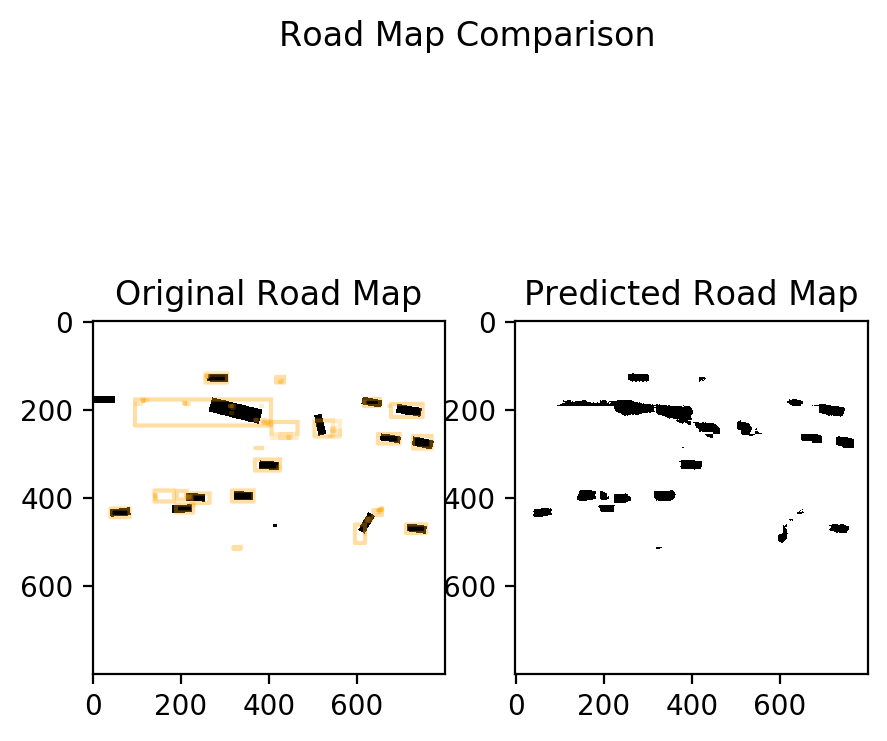

--------------------


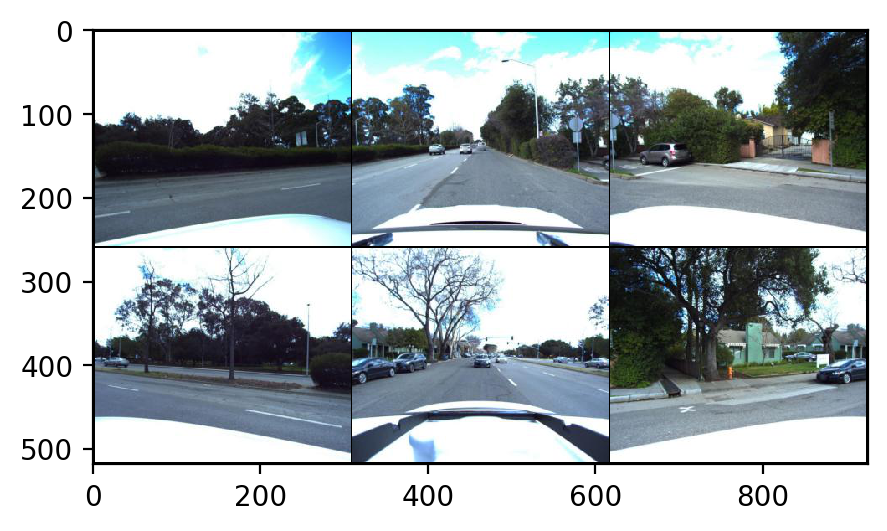

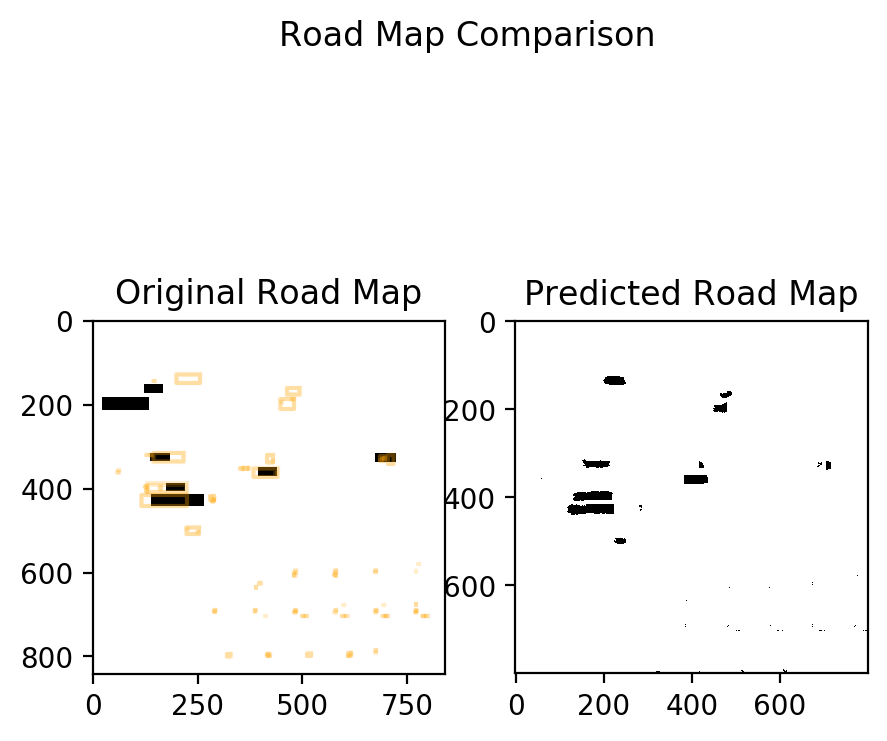

--------------------


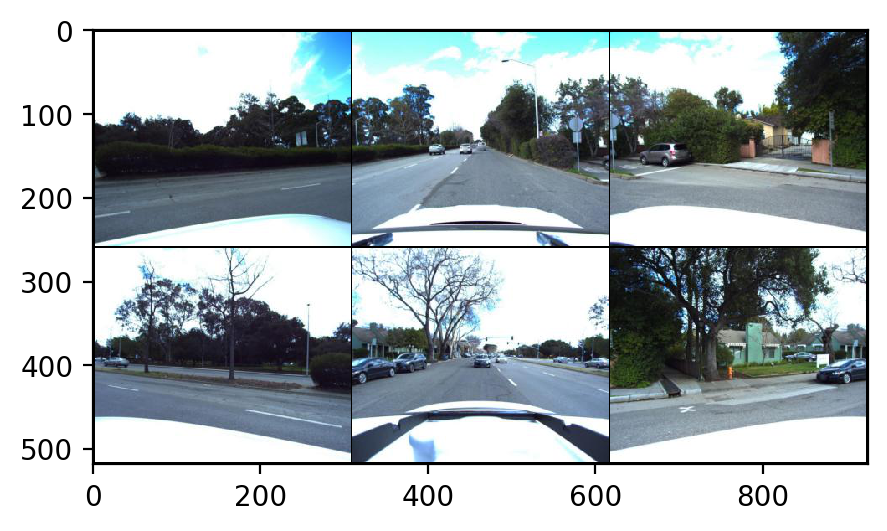

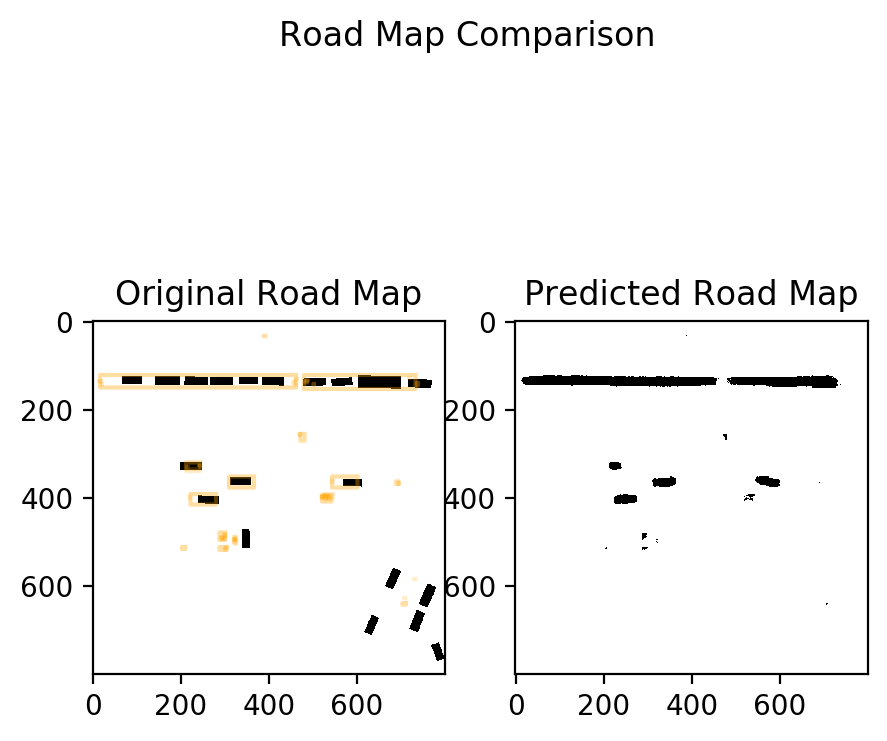

--------------------


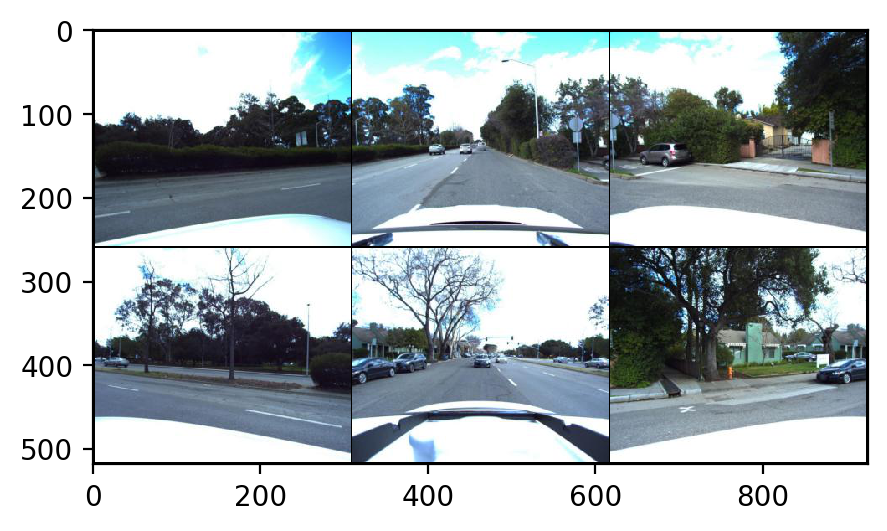

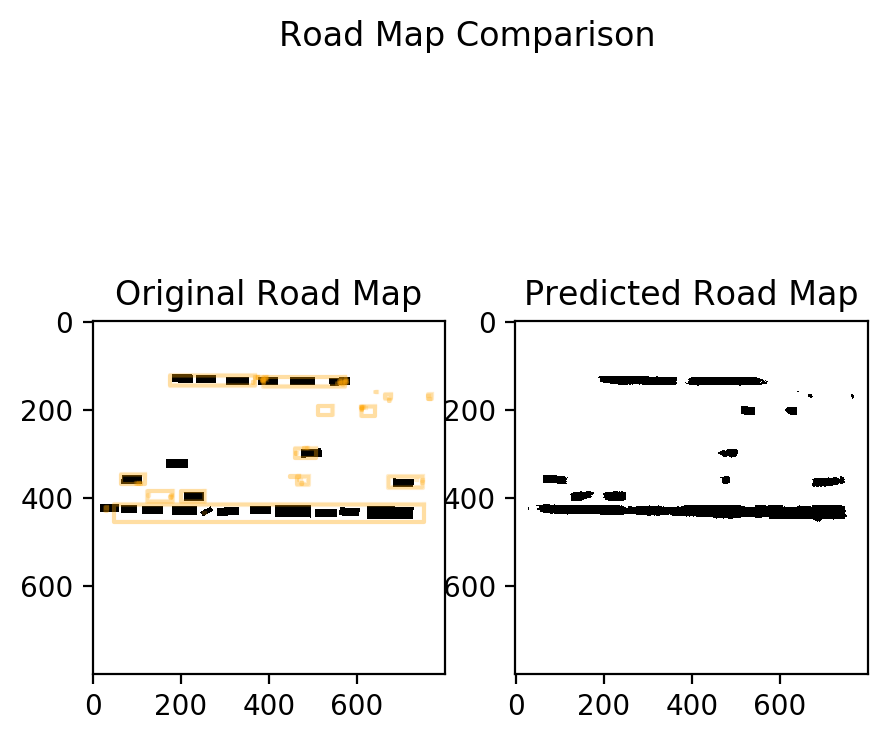

--------------------


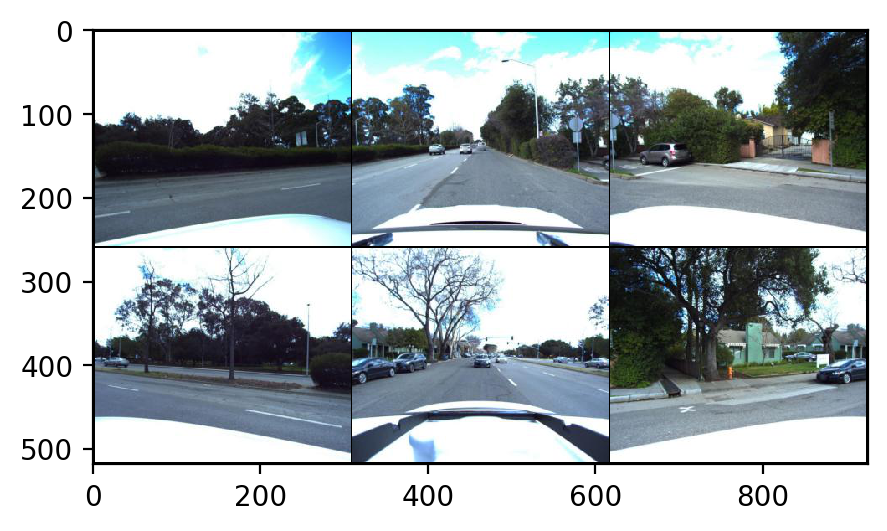

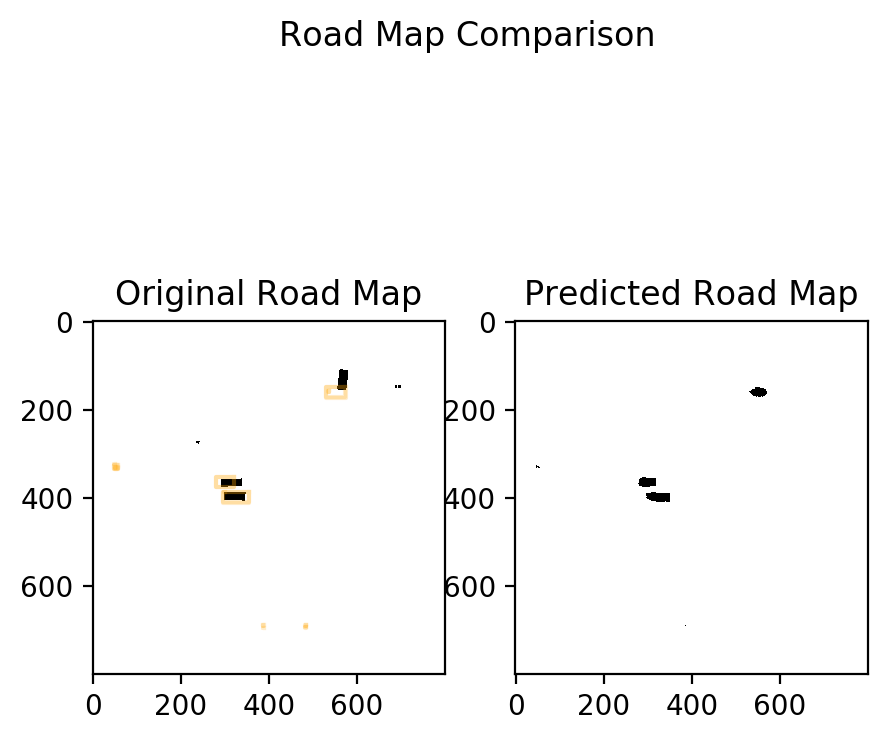

--------------------


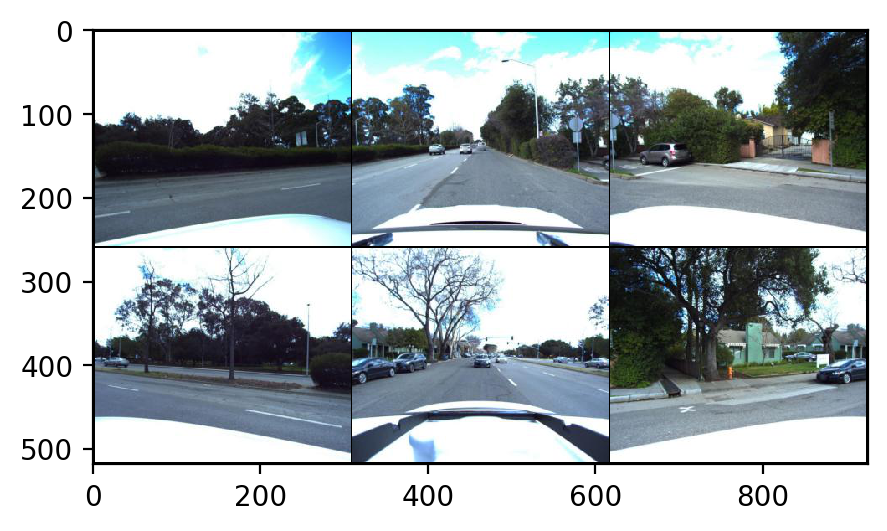

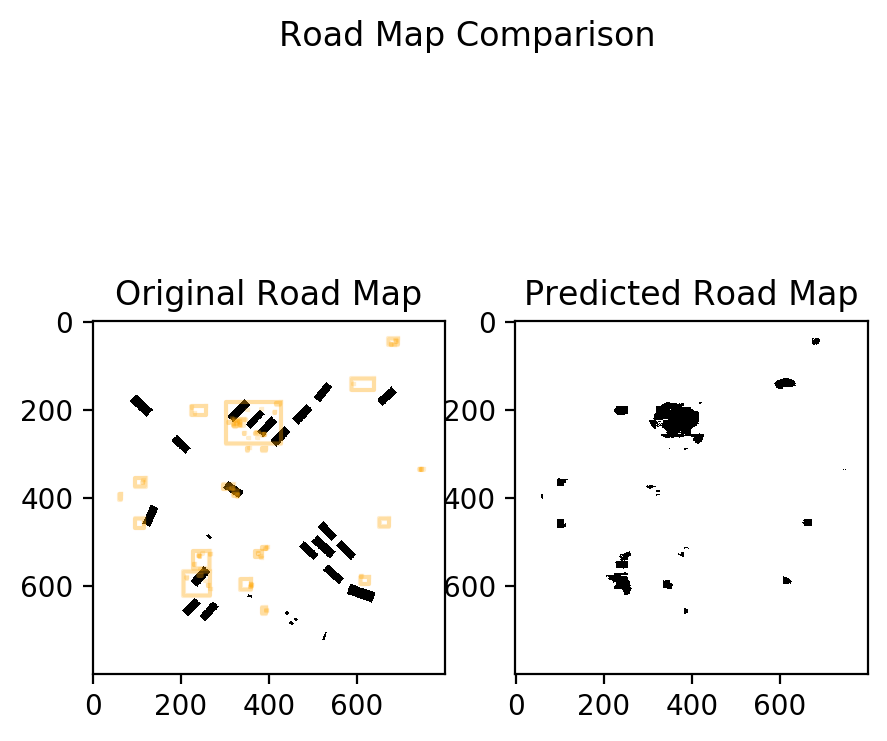

--------------------


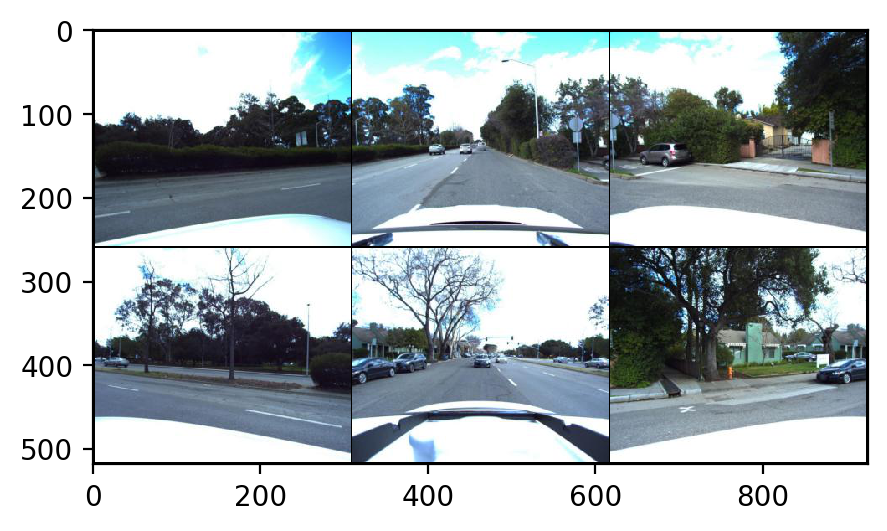

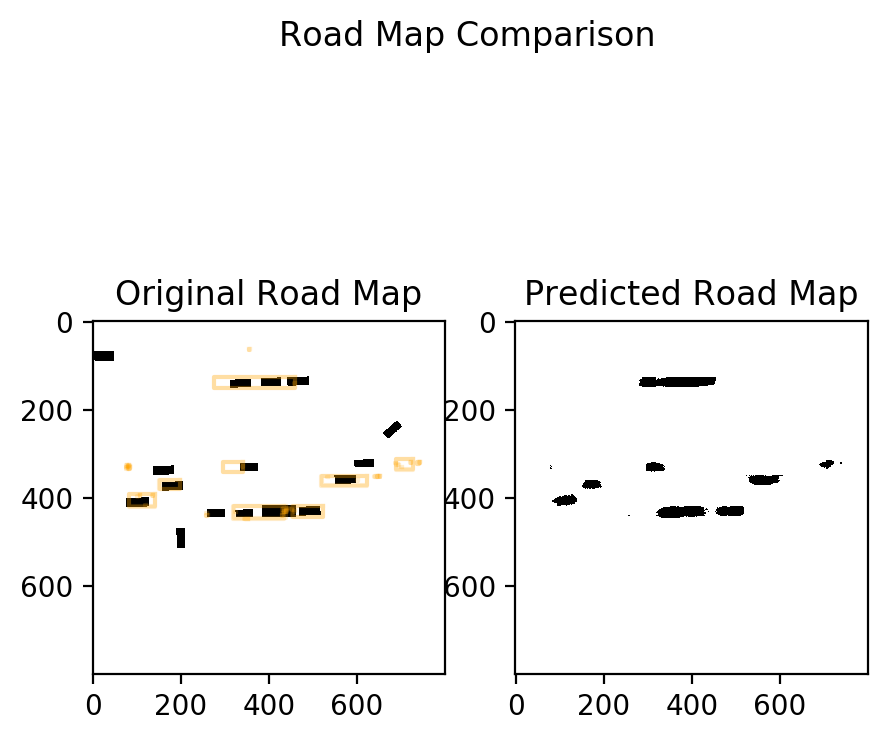

--------------------
Total samples: 32.0, Total Threat Score: 0.9201372861862183
Mean Threat Score is: 0.02875429019331932


In [35]:
phase = 'val'
threat_score = 0.0
total = 0.0
display_images = True

for i, temp_batch in enumerate(dataloaders[phase]):
    if i==2:
        break
    total += len(temp_batch[0])
    samples, targets, tar_sems, road_images, extras  = temp_batch
    samples = torch.stack(samples).to(device)
    road_images = torch.stack(road_images).to(device)
    tar_sems = torch.stack(tar_sems).to(device)
    with torch.set_grad_enabled(False):
        if model_type == 'ae':
            pred_maps = model(samples)
            loss = criterion(pred_maps, road_images.float())
        elif model_type == 'vae':
            pred_maps, mu, logvar = model(samples,False)
            loss, CE, KLD = loss_function(pred_maps, road_images, mu, logvar)

        for pred_map,tar_sem in zip(pred_maps,tar_sems):
            ts_road_map = compute_ts_road_map(pred_map > threshold, road_image)
            threat_score += ts_road_map

            if display_images:
                plt.imshow(utils.to_np(torchvision.utils.make_grid(samples[0], nrow=3)).transpose(1, 2, 0))
                fig, (ax1, ax2) = plt.subplots(1, 2)
                fig.suptitle('Road Map Comparison')
                ax1.imshow(tar_sem.detach().cpu(), cmap='binary');
                boxes = utils.get_bounding_boxes_from_seg(pred_map > 0.2, 10, 800, 800)
                for i, bb in enumerate(boxes):
                    # You can check the implementation of the draw box to understand how it works
                    draw_box(ax1, bb, color="orange", alpha=0.2)
                ax1.set_title('Original Road Map')
                ax2.imshow((pred_map > 0.2).detach().cpu(), cmap='binary');
                ax2.set_title('Predicted Road Map')
                plt.show()
                print('-'*20)
                
threat_score /= total
print('Total samples: {}, Total Threat Score: {}'.format(total,total*threat_score))
print('Mean Threat Score is: {}'.format(threat_score))

### Verifying Performance on Train set

In [ ]:
phase = 'train'
threat_score = 0.0
total = 0.0
display_images = False

for i, temp_batch in enumerate(dataloaders[phase]):
    if i==5:
        break
    total += len(temp_batch[0])
    samples, targets, road_images, extras  = temp_batch
    samples = torch.stack(samples).to(device)
    road_images = torch.stack(road_images).to(device)

    with torch.set_grad_enabled(False):
        if model_type == 'ae':
            pred_maps = model(samples)
            loss = criterion(pred_maps, road_images.float())
        elif model_type == 'vae':
            pred_maps, mu, logvar = model(samples,False)
            loss, CE, KLD = loss_function(pred_maps, road_images, mu, logvar)

        for pred_map,road_image in zip(pred_maps,road_images):
            ts_road_map = compute_ts_road_map(pred_map > threshold, road_image)
            threat_score += ts_road_map

        if display_images:
            plt.imshow(torchvision.utils.make_grid(samples[0].cpu(), nrow=3).numpy().transpose(1, 2, 0))
            fig, (ax1, ax2) = plt.subplots(1, 2)
            fig.suptitle('Road Map Comparison')
            ax1.imshow(road_image.detach().cpu(), cmap='binary');
            ax1.set_title('Original Road Map')
            ax2.imshow((pred_map > threshold).detach().cpu(), cmap='binary');
            ax2.set_title('Predicted Road Map')
            plt.show()
            print('-'*20)
                
threat_score /= total
print('Total samples: {}, Total Threat Score: {}'.format(total,total*threat_score))
print('Mean Threat Score is: {}'.format(threat_score))